In [2]:
import random
random.seed(14)
import numpy as np
import pandas as pd
import altair as alt
from matplotlib import pyplot as plt
import spacy
import warnings
warnings.filterwarnings("ignore")

In [3]:
#NLP models
nlp_sm = spacy.load("en_core_web_sm")
nlp_md = spacy.load('en_core_web_md')

In [4]:
#import data
CanadianCompanies_Dataset = pd.read_csv('CanadianCompanies_Dataset.csv')
CanadianCompanies_Dataset2 = pd.read_csv('CanadianCompanies_Dataset2.csv')
CanadianCompanies_Dataset3 = pd.read_csv('CanadianCompanies_Dataset3.csv')
CanadianCompanies_Dataset4 = pd.read_csv('CanadianCompanies_Dataset4.csv')
CanadianCompanies_Dataset5 = pd.read_csv('CanadianCompanies_Dataset5.csv')
#CanadianCompanies_Dataset6 = pd.read_csv('CanadianCompanies_Dataset6.csv')

CanadianCompanies = pd.concat([CanadianCompanies_Dataset,CanadianCompanies_Dataset2,CanadianCompanies_Dataset3,CanadianCompanies_Dataset4,CanadianCompanies_Dataset5],ignore_index = True)
CanadianCompanies.head()

,Unnamed: 0,Company,Position,Regional Data,Company Size,Industry,Revenue,Founded,Job Description
0,0,Canadian Pacific,Crew Dispatcher,"7550 Ogden Dale Road S.E., Calgary, AB","more than 10,000",Rail Transportation,Hidden by employer,1881.0,\nCanadian Pacific (CP) and Kansas City Southe...
1,1,Canadian Pacific,Industrial Electrician,"Winnipeg, MB","more than 10,000",Rail Transportation,Hidden by employer,1881.0,\nCanadian Pacific (CP) and Kansas City Southe...
2,2,Canadian Pacific,Benefits Manager - US,"7550 Ogden Dale Road S.E., Calgary, AB","more than 10,000",Rail Transportation,Hidden by employer,1881.0,\nCanadian Pacific (CP) and Kansas City Southe...
3,3,Canadian Pacific,Heavy Duty Mechanic,"7550 Ogden Dale Road S.E., Calgary, AB","more than 10,000",Rail Transportation,Hidden by employer,1881.0,\nCanadian Pacific (CP) and Kansas City Southe...
4,4,Canadian Pacific,"Specialist, Finance Systems and Reporting (SAP)","7550 Ogden Dale Road S.E., Calgary, AB","more than 10,000",Rail Transportation,Hidden by employer,1881.0,\nCanadian Pacific (CP) and Kansas City Southe...


In [5]:
comp = CanadianCompanies.iloc[:,[1,5,8]].dropna(subset=['Job Description','Industry']).reset_index(drop=True)
description = comp[['Job Description']]
comp

,Company,Industry,Job Description
0,Canadian Pacific,Rail Transportation,\nCanadian Pacific (CP) and Kansas City Southe...
1,Canadian Pacific,Rail Transportation,\nCanadian Pacific (CP) and Kansas City Southe...
2,Canadian Pacific,Rail Transportation,\nCanadian Pacific (CP) and Kansas City Southe...
3,Canadian Pacific,Rail Transportation,\nCanadian Pacific (CP) and Kansas City Southe...
4,Canadian Pacific,Rail Transportation,\nCanadian Pacific (CP) and Kansas City Southe...
...,...,...,...
2111,Wholesale Club,Retail & Wholesale,\nReferred applicants should not apply directl...
2112,Loblaws,Vehicle Dealers,\nReferred applicants should not apply directl...
2113,Real Canadian Superstore,Retail & Wholesale,\nReferred applicants should not apply directl...
2114,Fortinos,Vehicle Dealers,\n\n\n Job Description\n \n\n\n\n\n\n Why i...


In [6]:
#List of existing software
softlist = ['PDFCreator', 'XC (targets XMOS architecture)', 'Zonnon', 'Poisoned', 'ClusterPy (non-GUI, open source)GeoGrouper (GUI, free)', 'SAP Project System (PS)', 'Komodo Edit', 'KNIME', 'Smartsheet', 'Ori series', 'Miranda', 'Commander Keen series', 'ploticus', 'Sheetster', 'NCSS', 'Amiga E', 'Lyx', 'Microsoft Security Essentials', 'FoxBase/FoxPro', 'SAP PRD2(P2)', 'Disco', 'Halide (programming language)', 'DinkC', 'COMTRAN', 'xHarbour', 'Regression Analysis of Time Series (RATS)', 'SAP Business Explorer (Bex)', 'Hartmann pipelines', 'Microsoft Lens', 'SPS', '360FranTerra\n20/20iSite\nMarketMentor', 'Microsoft Windows', 'Microsoft Word 2013', 'Microsoft Visual Studio', 'Debian-Med', 'OpenBUGS', 'SANET', 'SMALL', 'SUDAAN', 'Codimg', 'MIT', 'Adium on Mac OS X', 'Bullzip PDF Printer', 'Kv (Kivy)', 'EXEC 2', 'KRL', 'Microsoft To Do', 'Chronux', 'Microsoft Project Server', 'Janus (time-reversible computing programming language)', 'HippoDraw', 'LINC', 'BBEdit', 'Digital Performer', 'OpenEMR', 'PL/0', 'Helix', 'LabPlot', 'SAP Composite Application Framework', 'PWCT', 'TED Notepad', 'SBL', 'Blender', 'Zoho Office Suite', 'OpenMRS', 'CPL', 'Address Book', 'Adobe Muse', 'Ardour', 'TurnKey Linux LAMP stack', 'WebDNA', 'OBJ2', 'GNU E', 'WiFi Explorer', 'Jess', 'Mathcad', 'SAP HANA', 'poppler', 'Analyse-it', 'Microsoft Office 2016 for Mac', 'DADiSP', 'CudaText', 'Shake', 'CHIP-8', 'Kingsoft Office', 'SAP Advanced Planner and Optimizer', 'ThinkFree Online Calc', 'Fortora Fresh Finance', 'Hopscotch', 'Color BASIC', 'Font Folio', 'Bochs', 'Microsoft Dynamics 365 Finance', 'Actor', 'Karel', 'GIS Spatial Analytics & Analysis', 'OpenOffice.org Calc', 'XeTeX', 'SPSS Modeler', 'ITK-SNAP', 'SAP Shipping Services Network (SSN)', 'ADMB', 'Napier88', 'Torque (game engine)', 'Finale', 'PowerBuilder – 4GL GUI application generator from Sybase', 'Multi-dimensional spreadsheets', 'Microsoft Content Management Server', 'BlueGriffon', 'Fantom', 'GNU Ubiquitous Intelligent Language for Extensions (GNU Guile)', 'AOLpress', 'BitDefender Antivirus for Mac', 'CorVision', 'Feedback Hub', 'TELCOMP', 'PCF', 'SYMPL', 'EGL', 'Microsoft Office PerformancePoint Server', 'Cayenne (Lennart Augustsson)', 'MSX BASIC', 'Windows CE', 'Scan', 'Macports', 'SAP Solutions for mobile business', 'Pizza', 'SPARK', 'Substance 3D family', 'Seashore', 'X-13ARIMA-SEATS', 'SAP Convergent Charging (CC)', 'Qlucore Omics Explorer', 'F*', 'SAP for Retail', 'Apple iWeb', 'BMDP', 'Internet Explorer', 'U', 'sc', 'Monster Truck Madness series', 'FrameMaker', 'Futhark', 'Lotus SmartSuite Lotus 123', 'XOTcl', 'SAP Manufacturing', 'EmEditor', 'SAP Analytics Cloud (SAC)', 'QBasic', 'Acrobat Reader', 'Audacity', 'P4', 'ProvideX', 'GaiaEHR', 'Alteryx', 'A.NET (A#/A sharp)', 'GeoDA', 'BASICA', 'JEAN', 'ORCA/Modula-2', 'Stateflow', 'LuciadLightspeed', 'iStumbler', 'TinyMCE', 'IconBuilder', 'MPlayer', 'FEATool Multiphysics', 'Prograph', 'FAUST', '3D Viewer', 'TeX', 'gretl', 'LabVIEW', 'Maya', 'Visual DialogScript', 'ALGOL 60', 'Telegram', 'Endrov', 'Studierfenster', 'MIDAS', 'Windows NT 3.1', 'Vim License', 'Google Drive app', 'Recycle', 'BlueFish', 'VirtualBox', 'Idris', 'SAP Business Intelligence (BI)', 'Macromedia HomeSite', 'Dart', 'As-Easy-As', 'Squeak', 'Claris Home Page', 'BricsCAD', 'Argus', 'Simple Spreadsheet', 'SAP Sales Cloud (previously: CallidusCloud)', 'OmniFocus', 'GNOME Text Editor', 'XMind', 'Bean', 'Emacs', 'CFEngine', 'Microsoft Hearts', 'RAPID', 'IronPython', 'Source', 'Adobe Document Cloud', 'Foxit Reader', 'Connect', 'XPL0', 'openEHR', 'Datalog', 'Armadillo', 'Microsoft Commerce Server', 'HOSxP', 'Tecplot', 'WPS Office', 'Breathing Games', 'Transmission (BitTorrent)', 'Cobra', 'WarpPLS', 'FLOW-MATIC (B0)', 'SAP S/4HANA Cloud', 'SIMSCRIPT', 'Uniface', 'CKEditor', 'Experience Manager', 'FlowVella', 'Aperture', 'OpenEpi', 'TIE', 'Alma-0', 'Inform', 'SAP Hybris', 'FlexPro', 'Microsoft Office 98 Macintosh Edition', 'OCaml', 'GPLv3', 'Kingsoft Office Spreadsheets 2012', 'DIBOL', 'Media Optimizer', 'Captivate Draft', 'SAP Fieldglass', 'Trac', 'Windows Preinstallation Environment', 'Emacs Lisp', 'WebStorm', 'J# (J sharp)', 'SETL', 'pandas', 'Q#', 'WYMeditor', 'Charm', 'Freeway', 'Spinnaker', 'Lite-C', 'Microsoft PowerPoint', 'SuperTalk', 'Mesa', 'Arc', 'Windows 2.1x', 'FL', 'Microsoft BASIC', 'Alarms & Clock', 'Affinity Designer', 'Hollywood', 'Windows Essentials', 'Windows Camera', 'NewtonScript', 'PEARL', 'Windows Media Player', 'Illustrator Draw', 'Medical open network for AI', 'TXL', 'Minitab', 'SAP CCMS, monitoring program', 'macOS Server', 'TAChart', 'Open Dental', 'μTorrent', 'Dreamweaver', 'Office 2004 for Mac', 'LAPACK', 'Unicon', 'Red', 'Windows Disk Defragmenter', 'SAP for Insurance (SAP for Insurance)', 'OS/2', 'I', 'SAP Marketing Cloud', 'AutoHotkey', 'BIRT Project', 'Microfit', 'Banjo-Kazooie series', 'Opal', 'Norton Antivirus for Mac', 'Exchange', 'Dog', 'Ipe', 'Microsoft Office 2007', 'TASC (The AppleSoft Compiler)', 'PDF.js', 'Growl', 'Office Mobile', 'M#', 'APL/ GPLv1', 'SAP NetWeaver Platform', 'Cog', 'Microsoft Office for Mac 2011', 'SAP Business Connector (deprecated/removed from product range)', 'FEniCS Project', 'Nix (Systems configuration language)', 'The Elder Scrolls series', 'SAP ERP', 'GMap Creator', 'Clipchamp', 'Visual C#', 'Siag', 'FP', 'Microsoft Pay', 'fre:ac', 'RocketCake', 'Snak', 'System Center Virtual Machine Manager', 'Common Lisp (also known as CL)', 'DB Lytix', 'Clean', 'Mondrian', 'Game Oriented Assembly Lisp (GOAL)', 'Autodesk Alias', 'Microsoft Works Spreadsheet', 'VSTS Profiler', 'JotSpot Tracker', 'HomeBank', 'Pages', 'SAP Transportation Management (TM)', 'XQuery', 'RapidWeaver', 'Microsoft Planner', 'Yahoo! Messenger', 'Zoho Sheet', 'Microsoft Small Basic', 'Discontinued', 'ACE', 'Opera', 'SISAL', 'LAMP', 'Collabora Online Calc', 'ITK', 'Ch', 'Fresco', 'LANSA', 'Easy PL/I', 'Steinberg 2019 Mac Pro', 'QuickBASIC', 'macOS', 'DataGrip', 'CodeWarrior', 'SAP Knowledge Warehouse (KW)', 'Authenticator', 'Adobe Capture', 'Komodo', 'Sawzall', "SAP NetWeaver BI (formerly SAP NetWeaver BW- 'BW' is still used to describe the underlying data warehouse area and accelerator components)", 'Nacsport Video Analysis Software', 'pdftk', 'Kaleidoscope', 'Microsoft Minesweeper', 'Forza series', 'SheepShaver', 'Orwell', 'Constraint Handling Rules (CHR)', 'SAP Business Partner Screening', 'MPL', 'Silex website builder', 'PyNets', 'Darwin', 'D3js', 'Premiere family', 'SQL', 'Acrobat Distiller', 'Adobe Sign', 'Acrobat', 'EZGenerator', 'Object Lisp', 'SAP Fiori for mobile devices announced in May 2013', 'Microsoft Paint', 'SNOBOL (SPITBOL)', 'Windows Speech Recognition', 'Pike', 'Azure DevOps Services', 'Lightroom', 'Solidity', 'Javelin', 'Kid Pix Deluxe 3X', 'NAG Library', 'TACL', 'StatXact', 'SKILL', 'NCR-DOS', 'WinZip', 'Visual LISP', 'Promela', 'Q (programming language from Kx Systems)', 'Codelobster', 'SLIP', 'Windows 11', 'Lens Profile Creator', 'FMRIB Software Library (FSL)', 'Amazon Kindle app', 'OnyX', 'Cybil', 'Ubercode', 'C++ (C plus plus) – ISO/IEC 14882', 'Racket', 'CHILL', 'Yoix', 'Camera Raw', 'ecto', 'SAP Supply Chain Performance Management (SCPM)', 'Modula', 'Figma', 'L', 'SAP Exchange Infrastructure (XI) (From release 7.0 onwards, SAP XI has been renamed as SAP Process Integration (SAP PI))', 'LibreOffice Writer', 'MBASIC', 'SAP BusinessObjects Lumira', 'Lustre', 'Windows 95', 'SIMPOL', 'EASYTRIEVE PLUS', 'XSharp (X#)', 'DaVinci Resolve', 'Julia', 'Microsoft Merchant Server', 'Disk Cleanup', 'Prelude Live Logger', 'iSync', 'Visual Studio Tools for Applications', 'Forth', 'PROMAL', 'Spreadsheet-related developmental software', 'ASReml', 'Microsoft Office 95', 'PL/M', 'SAP Strategic Enterprise Management (SEM)', 'PhpStorm', 'Font Development Kit for OpenType', 'Audion', 'Simul', 'HandBrake', 'Logic Express', 'jLab', 'SAGA', 'PLEX', 'Visual C++', 'KornShell (ksh)', 'M2001', 'Color (formerly Kuler)', 'Archiver', 'Halo series', 'Outlook on the web', 'Legoscript', 'KMyMoney', 'Powerhouse', 'Evince', 'Cython', 'Solitaire', 'Foxmail', 'Technical Communication Suite family', 'Midtown Madness series', 'Office on the web', 'SASL', 'POP-11', 'MS-DOS', 'Baudline', 'Wine', 'Google Earth', 'Lazarus', 'plotutils', 'CESIL (Computer Education in Schools Instruction Language)', 'FreeMat', 'Adenine (Haystack)', 'Microsoft SharePoint', 'Windows Server 2022', 'Macsyma', 'VisSim', 'Action!', 'Premiere Pro', 'Microsoft Power Platform', 'Minecraft series', 'SAP Ariba', 'VLC media player', 'Photoshop Elements Organizer[2]', 'CMS EXEC (EXEC)', 'Cilk (also Cilk++ and Cilk plus)', 'Whitebox GAT', 'Adobe Podcast', 'SAP Business Workflow', 'CC PDF Converter', 'Captivate Prime', 'Real Studio', 'ps2pdf', 'XploRe', 'GraphicConverter', 'Avid', 'ADaMSoft', 'Strongtalk', 'Microsoft Speech API', 'Diffusion Imaging in Python (DIPY)', 'SAP Auto-ID Infrastructure', 'IDRISI', 'AIR', 'Mountains', 'Microsoft Store', 'iA Writer', 'Self', 'SAP for Healthcare (ISH)', 'Windows Calculator', 'Gnumeric', 'Cg (High-Level Shader/Shading Language [HLSL])', 'SAP Production Planning (PP)', 'WIMP', 'HotDog', 'ABAP', 'Sheets', 'Ableton Live', 'Oberon', 'GNU Compiler Collection', 'Limbo', 'AppleScript', 'Photoshop Express', '3D Scan', 'Fract', 'Nim', 'SAP PLM', 'World Programming System (WPS)', 'Malbolge', 'Houdini', 'Microsoft Home', 'Boomerang', 'ixi software', 'Microsoft System Center', 'PowerShell', 'rc', 'SOCR', 'TAL', 'OPS5', 'Personal Capital', 'Type family', 'Framework', 'SAP Test Data Migration Server (TDMS)', 'Scene It? series', 'Bitnami MAMP Stack', 'ABC ALGOL', 'Wolfenstein series', 'Hamilton C shell', 'Kotlin', 'SAP Business ByDesign', 'Microsoft Forefront Threat Management Gateway', 'Csound', 'SAP for Public Sector (IS PSCD)', 'PDF-XChange Viewer', 'NCAR Command Language', 'WebAssembly', 'Ada – ISO/IEC 8652', 'MLwiN', 'DAP', 'WAMP', 'Bing Bar', 'Visifire', 'LibreOffice Online Calc', 'Windows Vista', 'tkWWW', 'J', 'Business Catalyst', 'Windows NT 4.0', 'G-code', 'Microsoft Office for Mac', 'SAP Solution Manager', 'Zend Server Community Edition', 'GDScript (Godot)', 'GNU Health', 'Microsoft Forefront Unified Access Gateway', 'SAP for Oil & Gas (IS Oil & Gas)', 'Adobe Reader', 'ALF', 'Stuffit', 'Internet Explorer for Mac', 'Wyvern', 'LISREL', 'THIRRA', 'Logic Studio', 'Mortran', 'TTCN (Tree and Tabular Combined Notation)', 'NCSS (statistical software)', 'S-PLUS', 'Stata', 'Creative Cloud', 'O', 'Windows 3.1x', 'Microsoft Office Excel', 'Brain Image Analysis Package', 'JCL', 'GNUmed', 'Account Access', 'CutePDF', 'Crystal', 'Fast Healthcare Interoperability Resources (FHIR)', 'NFL Fever series', 'SAP Enterprise Buyer Professional (EBP)', 'Wolfram Language', 'ColdFusion', 'PageStream', 'JADE', 'ChitChat', 'Microsoft 365', 'OmniOutliner', 'NESL', 'vMac', 'T-SQL (Transact-SQL)', 'DaisyDisk', 'Pillars of Eternity series', 'Photoshop Fix', 'Adobe Dreamweaver', 'Clipper', 'Simulink', 'Audience Manager', 'Conker series', 'PHPEdit', 'Obliq', 'SageMath', 'Opera Dragonfly', 'Sybase ASE', 'ggplot2', 'UltraEdit', 'DataFlex', 'MedinTux', 'Archive Utility', 'Delve', 'APMonitor', 'ClearHealth', 'QPDF', 'Microsoft Bookings', 'Automator', 'Unity', 'Mint', 'HolyC (TempleOS)', 'Fonts (formerly Typekit)', 'Flix', 'Common Intermediate Language (CIL)', 'Magento Commerce Cloud', 'Crackdown series', 'mlpack', 'aMSN', 'Office Online', 'Kinect Sports series', 'High Level Shader Language (HLSL)', 'Microsoft Access', 'EPL (Easy Programming Language)', 'SequenceL', 'Windows Photo Viewer', 'Microsoft SwiftKey', 'CUPS', 'Mystic Programming Language (MPL)', 'Windows Mobile', 'Gears of War series', 'SAP NetWeaver Application Server (Web AS)', 'SAP NetWeaver Identity Management', 'Hop', 'Gosu', 'Audio Hijack', 'DHIS', 'Epigram', 'baudline', 'pstoedit', 'Photoshop Mix', 'Okular', 'VMware Fusion', 'Batch file (Windows/MS-DOS)', 'Mailplane', 'Final Cut Express', 'Curl', 'Commodore BASIC', 'Windows Defender', 'Xbox Development Kit', 'Fallout series', 'Pict', 'Mozilla Firefox', 'Pyspread', 'IGOR Pro', 'HTML-Kit', 'Paint 3D', 'PLEXIL', 'JASS', 'Yahoo! Widget Engine', 'Microsoft Office 2003', 'NeoOffice Calc', 'FreeSurfer', 'bc (basic calculator)', 'X10', 'SigmaPlot', 'Fortress', 'MOO', 'TPU (Text Processing Utility)', 'SAP Data Warehouse Cloud (DWC)', 'HoloStudio', 'ZetaLisp', 'Substance 3D Modeler', 'Xcode', 'Crimson Skies series', 'gDoc Fusion', 'SAP IQ', 'Perl', 'Stellarium', 'Toi', 'Killer Instinct series', 'TerraLens', 'Unistat', 'FAMP[2]', 'C-- (C minus minus)', 'Speakeasy', 'Photoshop Camera', 'pdfTeX', 'HAL/S', 'Windows API', 'Squirrel', 'GIMPShop', 'Visual Basic .NET', 'Windows Server', 'OmniWeb', 'Xod', 'Bridge', 'Webflow', 'CLU', 'TECO (Text Editor and Corrector)', 'FrameMaker Publishing Server', 'G', 'Jimdo', 'Feedly', 'Mobirise', 'Mercury', 'RoboHelp Server', 'Stagecast Creator', 'TACPOL', 'Verse', 'Mono', 'SuperCROSS', 'PeopleCode', 'PDFBox', 'Internet-Checkers', 'SAP Master Data Governance (MDG)', 'Axum', 'QuakeC', 'Fontographer', 'Paintbrush', 'SOPHAEROS', 'Apple Pages', 'POV-Ray SDL', 'SimThyr', 'Teechart', 'MIMIC', 'Sherlock', 'Pure Data', 'Free Pascal', 'Power Apps', 'Starlogo', 'Windows PowerShell', 'ILNumerics.Net', 'MINUIT', 'Adobe Brackets', '3D-Coat', 'Mulberry', 'GNU Octave', 'Pharo', 'Resolver One', 'Windows 2.0x', 'Lava', 'WebKit', 'Hyper-V', 'SAP AppGyver', 'Machine code', 'Windows Chat', 'Nial', 'MedCalc', 'SnapEditor', 'Adobe After Effects', 'Medium by Adobe', 'BioLinux', 'Metapad', 'Camino', 'StarOffice Calc', 'SR', 'iWork', 'Qalb', 'OpenDX', 'Bash', 'You Need a Budget', 'B', 'Language H', 'Tor', 'Microsoft Agent', 'MarsEdit', 'REAPER', 'ReBirth', 'SuperCard', 'Winpepi', 'Edinburgh IMP', 'Hermes', 'SAP R/2', 'Apple Books', 'Apache Web Server', 'CLIPS', 'Fragstats', 'RubyMine', 'Foxit PhantomPDF', 'Apple Media Tool', 'Python', 'System Center Configuration Manager', 'Modula-2', 'SAP R/3', 'GNU Oleo', 'Media Encoder', 'DNG Profile Editor', 'SIGNAL', 'MAPPER (now part of BIS)', 'AIDA', 'Office Remote', 'Janus (concurrent constraint programming language)', 'Gears series', 'LimeWire', 'BIAS Peak', 'occam', 'JAGS', 'Microsoft Bob', 'Xtend', 'Premiere Elements', 'The Spinal Cord Toolbox (SCT)', 'GRASS', 'SAP Business Information Warehouse (BW)', 'iWeb', 'Xbox Game Pass', 'Registry Editor', 'Spectrum', 'FineReader', 'InDesign', 'Creative Cloud family', 'PDF-XChange', 'Foxit PDF Editor Suite', 'TUTOR (PLATO Author Language)', 'Transcript (LiveCode)', 'Jython', 'Enterprise Central Component (ECC)', 'Soda PDF', 'LiveScript', 'XSB', 'McAffee VirusScan', 'SAP Advanced Data Migration', 'Adobe Director', 'CleanGenius', 'MAD/I', 'Revolution Analytics', 'Journler', 'Euphoria', 'C# (C sharp) – ISO/IEC 23270', 'Microsoft Liquid Motion', 'Madagascar', 'Sysquake', 'Datacopia', 'Simfit', 'Smallpdf Desktop', 'After Effects', 'Hy', 'PyCharm', 'FOIL', 'Microsoft Visual SourceSafe', 'Microsoft Exchange Server', 'EJS', 'Speakeasy (computational environment)', 'M Formula language', 'Microsoft Office 2021', 'CricketGraph', 'ILWIS Open', 'C Shell (csh)', 'Microsoft Mahjong', 'Project Gotham Racing series', 'Mathematica', 'Chapel (Cascade High Productivity Language)', 'Q', 'P′′', 'SOFA Statistics', 'CSPro', 'Orc', 'TMG (TransMoGrifier), compiler-compiler', 'MIVA Script', 'Biodiverse', 'Acrobat PDF Pack', 'Map Comparison Kit (MCK)', 'D', 'Ladder', 'CamBA', 'ActionScript', 'Grace', 'Fityk', 'AdvPL', 'NetSpot', 'Stellar Data Recovery', 'CobolScript – COBOL Scripting language', 'Homebrew', 'IBM Informix-4GL', 'Microsoft FreeCell', 'Microsoft Plus!', 'Logic Pro and MainStage', 'Salome', 'XSLT', 'Microsoft Visual Studio Code', 'doPDF', 'XAMPP', 'Psi', 'J++ (J plus plus)', 'cTAKES', 'X-Chat Aqua', 'Eudora', 'Z', 'Microsoft Macro Assembler', 'Yorick', 'Windows 7', 'AMPL', 'R++', 'System Center Advisor', 'EViews', 'Lightwave', 'iPhoto', 'Moneyspire', 'NWScript', 'Outlook.com', 'Microsoft Edge', 'FORMAC (FORMula MAnipulation Compiler)', 'Microsoft Silverlight', 'BBEdit Lite', 'Galaxy', 'Pipelines', 'Shareware', 'Eclipse', 'NuGet', 'DAMP[1]', 'Omnis Studio', 'Javelin PDF Reader', 'QPL', 'ScratchJr', 'DOSBox', 'Shotcut', 'LaTeX, TeX', 'E', 'AutoLISP / Visual LISP', 'Command Prompt', 'RalliSport Challenge series', 'Mary', 'Adobe Bridge', 'Adobe LiveMotion', 'PPL', 'Subtext', 'Microsoft Office 2000', 'Plotly', 'Cortana', 'QtiPlot', 'Statgraphics', 'Mellel', 'FaceTime', 'IBM Basic assembly language', 'SeaMonkey', 'HAGGIS', 'FirstPage', 'Hawths Tools', 'Smalltalk', 'Good Old Mad (GOM)', 'SAP Design Studio', 'PL/SQL', 'Hercules emulator', 'LSL', 'Statgraphics Sigma Express', 'Microsoft Visual Web Developer Express', 'Flock', 'HoTMetaL', 'Rguroo Statistical Software', 'RealPlayer', 'Xbox Live Gold', 'SciDAVis', 'Perl Data Language', 'NEWP', 'Internet Information Services', 'Qt Creator', 'WordPerfect Office Quattro Pro', 'UnrealScript', 'iCab', 'Magik', 'Apache OpenOffice', 'MaxScript internal language 3D Studio Max', 'Presenter Video Express', 'REFAL', 'COMAL', 'NITRC (Neuroimaging Informatics Tools and Resources Clearinghouse)', 'C – ISO/IEC 9899', 'Substance 3D Stager', 'Icon Composer', 'Lisp – ISO/IEC 13816', 'Microsoft Stream', 'EPL', 'Tiki Wiki CMS Groupware', 'SAP Business One', 'Workfront', 'OpenUI5', 'JMulTi', 'SiMPLE', 'SAP Central Process Scheduling, process automation and job scheduler', 'Viva Piñata series', 'Dashboard', 'Grab', 'TRS-80 Level II BASIC', 'Flex', 'Utopia Documents', 'Timbuktu', 'WaveBurner', 'SAP FICO', 'Ulysses', 'Superplan', 'KPP', 'Psychonauts series', 'Ratfor', 'Montage', 'Ruby', 'PAW', 'Lightroom Classic', 'PDF Studio', 'N', 'Windows 10', 'Adobe Comp', 'Shogun', 'R', 'Vim', 'Microsoft MACRO-80', 'WordBASIC', 'MuPDF', 'Time Machine (macOS)', 'Planner', 'RoboHelp', 'Fable series', 'Adobe Fireworks', 'SAP S/4HANA', 'OriginPro', 'Final Cut Studio', 'Content Server', 'Boo', 'EditGrid', 'xBase++ (xBase plus plus)', '3DSlicer', 'AOL Instant Messenger', 'MDL', 'SAP NetWeaver Visual Composer', 'Coldstone game engine', 'Rider', 'Postbox', 'Aptana', '3D Slicer', 'D (also known as dlang)', 'SmartPLS', 'SAKO', 'eCATT', 'VisIt', 'SOL', 'Midori', 'Snap!', 'Hope', 'iRows', 'Picolisp', 'SAP Business One (Small enterprise ERP 6.2, 6.5, 2004, 2005, 2007, 8.8x, 9.X, 10.x)', 'SAP BusinessObjects Web Intelligence (Webi)', 'iBank', 'Microsoft Power Fx', 'Content Viewer', 'Microsoft Project', 'QuickTime Pro', 'OpenOffice.Org', 'Nano', 'M4', 'C*', 'GeoGebra', 'Ceylon', 'ZOPL', 'Plus', 'SAP Advanced Business Application Programming', 'think-cell chart', 'Spark Video', 'AutoCAD', 'Microsoft Office 2001', 'CrimeStat', 'NeuroKit', 'LibreOffice', 'Lips series', 'GPLv2', 'Minesweeper', 'Jacket', 'OpenPDF', 'Microsoft Office 2016', 'S-Lang', 'QGIS', 'JasperReports', 'PASS Sample Size Software (PASS)', 'CLion', 'Apex (Salesforce.com, Inc)', 'ELAN', 'Brackets', 'Whiley', 'Statistica', 'S/SL', 'Microsoft Host Integration Server', 'Extension Builder', 'ZBrush', 'S', 'Microsoft Office XP', 'EusLisp Robot Programming Language', 'Intego VirusBarrier', 'Solid PDF Tools', 'SAP Solution Composer', 'R-Analysis of Spatial Data', 'LONI Pipeline', 'Zeno', 'ArchiCAD', 'On-Screen Keyboard', 'Microsoft Flight Simulator series', 'Process Monitor', 'Ace Distributed Application Specification Language (DASL)', 'GPLv1', 'AppCode', 'Microsoft Expression Studio', 'Croizat', 'DATATRIEVE', 'jq', 'Hospital OS', 'Preview', 'Photos', 'Magma', 'CORAL, Coral 66', 'Adobe InDesign', 'MHEG-5 (Interactive TV programming language)', 'Polarr', 'Angoss', 'MechAssault series', 'ClickOnce', 'SAP Enterprise Services Architecture', 'Zoo Tycoon series', 'Experience Cloud family[1]', 'Microsoft Visual Studio Express', 'Creative Writer', 'ActiveState Komodo', 'iLife', 'SAP Integrated Business Planning (IBP)', 'Skype', 'Claire', 'Bootstrap Studio', 'iCalamus', 'Scilab', 'Spectravideo Extended BASIC', 'Esterel', 'Windows NT 3.51', 'FAME', 'SabreTalk', 'Nightscout', 'Short Code', 'GoLand', 'LISA', 'iTunes', 'DigiSigner', 'PrimoPDF', 'SAP Rapid Deployment Solutions (RDS)', 'Hearts', 'Nitro PDF Pro', 'iHRIS', 'MATH-MATIC', 'VBScript', 'AppleWorks', 'Oak', 'SAP Profitability and Cost Management (PCM)', 'npm', 'Dynamic Link', 'SAP EHSM (Environment Health & Safety Management)', 'PageDefrag', 'Adobe Photoshop', 'F# (F sharp)', 'GraphTalk (Computer Sciences Corporation)', 'Pixelmator', 'HTML-NOTEPAD', 'Windows Phone', 'MSL', 'Not Quite C (NQC)', 'Strand', 'AIMMS', 'MATLAB', 'PhpStorm IDE', 'Pure', 'Visual J++ (Visual J plus plus)', 'Primetime', 'Serif PagePlus', 'SP/k', 'DivX', '3D Builder', 'deskPDF', 'Pico', 'X++ (X plus plus/Microsoft Dynamics AX)', 'Windows Subsystem for Linux', 'V (also known as vlang)', 'Activity Monitor', 'DAX (Data Analysis Expressions)', 'ERDAS IMAGINE', 'Systat', 'Xsan', 'EEGLAB', 'OpenVera', 'SAP HANA (formerly known as High-performance Analytics Appliance)', 'LibreOffice Calc', 'dc', 'Cryptol', 'Ginkgo CADx', 'Voreen', 'LiveCode', 'Line Rider series', 'KOffice', 'Ease', 'Orthanc', 'Bluebeam Revu', 'MuPAD', 'Microsoft FrontPage', 'ResEdit', 'Sed', 'Palringo', 'SAP SuccessFactors', 'Geany', 'Céu', 'Adobe Flash', 'Waffles', 'CDFinder', 'Mouse', 'scikit-learn', 'GarageBand', 'intrinsic Noise Analyzer (iNA)', 'Sysinternals utilities', 'Apple Remote Desktop', 'Windows 9x', 'Scheme', 'Fill & Sign DC', 'Notepad++', 'MUMPS', 'SAP for Telecommunications (IST)', 'Karelia Watson', 'Archim', 'Windows 2000', 'Calendar (Windows)', 'vim', 'Singularity', 'Graphviz', 'Analysis of Functional NeuroImages (AFNI)', 'Sather', 'Caml', 'Prey series', 'PL/B', 'Apple Qmaster and Qadministrator', 'Creative Cloud Express', 'Opera Mail', 'SAP GRC (Governance, Risk and Compliance)', 'Google Web Designer', 'Inkscape', 'Ledger', 'Apache PDFBox', 'Microsoft Dynamics SL', 'Sonic Visualiser', 'acslX', 'Babbage', 'LabKey Server', 'Kate', 'ACC', 'HelpNDoc', 'BitTorrent client', 'WampServer', 'Neural Designer', 'PySAL', 'Miro Media Player', 'Microsoft BackOffice Server', 'NetLogo', 'Altair BASIC', 'Y', 'LaunchBar', 'Continuity of Care Document', 'PowerCADD', 'TK Solver', 'LIL', 'PL/P', 'Character Animator', 'CLIST', 'SenseTalk', 'LotusScript', 'XD', 'NetObjects Fusion', 'Alef', 'Seed-based d mapping (SDM)', 'DVD Player (Apple)', 'Microsoft Narrator', 'DYNAMO', 'SAS', 'SAP Apparel and Footwear Solution (AFS)', 'NewsFire', 'Kopete', 'Microsoft Identity Integration Server', 'Go!', 'ROOT', 'CDuce', 'Mohol', 'MagicPlot', 'Neko', 'System Settings', 'Spreadsheet 2000', 'SAP BPC (Business Planning and Consolidation, formerly OutlookSoft)', 'Microsoft Magnifier', 'Escher', 'SAP CRM', 'Wix.com', 'Emerald', 'Draco', 'ISLISP', 'LIMDEP', 'HomeSite', 'Sophos', 'S2', 'Eiffel', 'Mango', 'Poppler-utils', 'FileMaker', 'SuperCollider', 'The Unscrambler', 'Webix', 'NewLISP', 'Microsoft Site Server', 'Visual Basic', 'TextEdit', 'Curry', 'BAPP', 'Apple iWork Numbers', 'PureScript', 'Component Pascal', 'GitHub', 'Z++', 'Age of Empires series', 'Celtx', 'Eclipse with the Web Tools Platform', 'Mozilla', 'Agora', 'Microsoft Ultimate Word Games', 'KIF (Knowledge Interchange Format)', 'PagePlus', 'Celestia', 'RPG', 'pcAnywhere', 'LC-3', 'Fortran – ISO/IEC 1539', 'MPD', 'SAP Service and Asset Management', 'Microsoft Dynamics GP', 'EazyDraw', 'H', 'Fink', 'MacLinkPlus Deluxe', 'Microsoft Office 97', 'SAP Cost Center Accounting (CCA)', 'Backup', 'Processing', 'Adobe Encore', 'Maqetta', 'Visual Basic for Applications', 'P', 'M', 'Accent (Rational Synergy)', 'SPSS', 'Illustrator', 'Join Java', 'Microsoft Anti-Virus', 'GnuCash', 'TextPad', 'Spreadsheets on different paradigms', 'Delphi', 'DRAKON', 'Quattro Pro', 'Lucid', 'Universal Document Converter', 'OpenEdge Advanced Business Language (ABL)', 'BlooP', 'Genedata', 'KompoZer', 'File Explorer', 'MAD (Michigan Algorithm Decoder)', 'Xara Photo & Graphic Designer', 'Microsoft Expression Web', 'Mapcite', 'Euler Mathematical Toolbox', 'Konqueror', 'Fjölnir', 'Pascal – ISO 7185', 'High Level Assembly (HLA)', 'Zathura', 'Windows 3.0', 'Prince', 'ArKaos', 'Xojo', 'Microsoft Works', 'Search Server', 'SimpleText', 'SAP Extended Warehouse Management (EWM)', 'Chromium', 'SAP GUI', 'Visual Objects', 'SAP Sustainability Performance Management (SUPM)', 'RoboHelp Classic', 'Microsoft Word', 'Havok', 'Browstat', 'Windows 1.0x', 'Advertising Cloud', 'PARI/GP', 'Entourage', 'Oxygene', 'Hume', 'Microsoft WebMatrix', 'JScript', 'MSN', 'ObjectLOGO', 'Quicksilver', 'Ease of Access', 'C', 'S3', 'Vim script', 'Haskell', 'Source Libraries', 'FreeCell', 'Microsoft Family Safety', 'Butler', 'KisMAC', 'rTorrent', 'Malwarebytes', 'Elm', 'APL', 'Geometric Description Language (GDL)', 'KRC', 'XEmacs', 'AppZapper', 'COMPAQ-DOS', 'Stock', 'Z shell', 'SAP Information Design Tool (IDT)', 'Statistical parametric mapping (SPM)', 'Chess Titans', 'Adobe PageMill', 'GW-BASIC', 'CDDL/ GPLv2/ LGPLv2.1', 'Processing.js', 'Mousepad', 'REXX', 'PDF24 Creator', 'KRL (KUKA Robot Language)', 'OpenNN', 'PDFsharp', 'Ploticus', 'MARK-IV (now VISION:BUILDER)', 'XLfit', 'IronRuby', 'Presenter', 'eC', 'Patch Analyst', 'OpenHospital', 'PDFedit', 'Grafana', 'PLANC', 'Trilinos', 'DVD Studio Pro', 'Open Programming Language (OPL)', 'LINQ', 'Microsoft SharePoint Designer', 'Exchange Online Protection', 'Azure DevOps Server', 'Netscape Navigator', 'TADS (Text Adventure Development System)', 'Skype for Business Server', 'Visual J++', 'IDL', 'IMSL Numerical Libraries', 'LilyPond', 'Direct3D', 'ONLYOFFICE - Community Server Edition', 'WinBUGS', 'System Center Essentials', 'Discord', 'Redcode', 'FFP', 'Solid Converter PDF', 'SAP for Media (ISM)', 'Pdftk', 'AngelScript', 'SAP Business ByDesign (ByD)', 'IBM Lotus Symphony', 'Logo', 'RRDtool', 'SML', 'Impro-Visor', 'Macromedia Authorware', 'AltspaceVR', 'SyncToy', 'LIBSVM', 'Newspeak', 'ALGOL 68', 'SciPy', 'Imaris', 'Microsoft Outlook Hotmail Connector', 'SAIL', 'Microsoft Dynamics 365 Sales', 'GNU Data Language', 'GrADS', 'BCPL', 'Shadowrun series', 'Windows NT', 'DCL (DIGITAL Command Language)', 'PV-WAVE', 'VTK', 'Ready, Set, Go!', 'Modelica', 'ParaView', 'Corel Painter', 'Windows Live OneCare', 'Windows SDK', 'HotSpot', 'InVesalius', 'Primer-E Primer', 'Flavors', 'Acrobat Export PDF', 'XBL', 'Captivate', 'Power Automate', 'Visual Studio Lab Management', 'Coq', 'Applesoft BASIC', 'RJ TextEd', 'Behance', 'Kojo', 'Campaign', 'Outlook Express', 'Microsoft Math Solver', 'Xbox Game Pass Ultimate', 'Cypher Query Language', 'Hack', 'Flip', 'Maude system', 'SymPy', 'Mahjong Titans', 'Microsoft Office v. X', 'CrossOver', 'Windows XP', 'ArcGIS', 'WebObjects', 'DivX Player', 'Modula-3', 'Ring', 'UNITY', 'OmniGraffle', 'MathCad', 'FreeMind', 'JOSS', 'FFmpeg', 'SAP Incentive and Commission Management (ICM)', 'GNU MCSim', 'Perfect Dark series', 'Swift (parallel scripting language)', 'Max', 'SAP Sales and Distribution (SD)', 'Quicken', 'Microsoft Outlook', 'GitHub Copilot', 'eCopy PaperWorks /  eCopy PDF Pro Office[4]', 'Microsoft Desktop Optimization Pack', 'Battletoads series', 'MSX-DOS', 'Carbon', 'Rattle GUI', 'Simplygon', 'Java', 'K', 'Boot Camp', 'Mainstage', 'System Center Data Protection Manager', 'LPC', 'AWK', 'T', 'WebPlus', 'NVu', 'FlooP', 'Apache OpenOffice Calc', 'Ubuntu-Med', 'OneDrive', 'O-Matrix', 'Windows Server 2012', 'IBM RPG', 'Microsoft Autofill', 'Microsoft Visio', 'Collabora Online', 'Windows Server 2016', 'Caisis', 'statsmodels', 'Lithe', 'Reason', 'SAP Converged Cloud', 'Cecil', 'WordPerfect', 'Xbox Game Studios', 'SAP Internet Transaction Server (ITS)', 'CEEMAC', 'BLISS', 'TEX (Text Executive Programming Language)', 'Zebra, ZPL, ZPL2', 'Zune', 'Amaya', 'Compact Pro', 'SHAZAM (Econometrics and Statistics Software)', 'SAP Supply Chain Management (SCM)', 'Dataplot', 'RapidMiner', 'Shiira', 'V', 'SAP NetWeaver Single Sign-On', 'SPIN', 'A+ (A plus)', 'Pro*C', 'Fuzion Frenzy series', 'RiffWorks', 'COWSEL', 'ISAS (Ictal-Interictal SPECT Analysis by SPM)', 'MoneyWiz', 'Oz', 'The Print Shop', 'Visual Studio Code', 'o:XML', 'Formatting Objects Processor', 'Winbatch', 'Stickies', 'Purble Place', 'jamovi', 'Windows RT', 'Script Debugger', 'LibreOffice Draw', 'Sybase SQL Anywhere', 'DataGraph', 'HRHIS', 'Logtalk', 'ML', 'Photoshop Elements', 'Alice (Alice ML)', 'SAP Cloud for Customer (C4C)', 'Programming with Big Data in R (pbdR)', 'Nitro PDF Reader', 'System Center Service Manager', 'F-Script', 'SAP xApps', 'TTM', 'Dimension', '86-DOS', 'HomeOS', 'Game Maker Language', 'Analytics', 'Microsoft Forefront', 'Photoshop family', 'NAG Numerical Library', 'iMessage', 'GeoDa [1]', 'Amira 3D', 'SAP Portal (EP)', 'Character Map (Windows)', 'KEE', 'Power Automate Desktop', 'LiveChat', 'OptimJ', 'Karbon', 'JavaFX Script', 'GOTRAN (IBM 1620)', 'Groovy (by Apache)', 'Microsoft Messenger for Mac', 'Roxio Toast', 'Maple', 'PortablE', 'Visual Prolog', 'AbiWord', 'EasyOffice EasySpreadsheet', 'Mavis Beacon Teaches Typing', 'State of Decay series', 'JavaScript', 'Ezhil', 'Tableau', 'Factor', 'WriteNow', 'Path Finder', 'Golo', 'Euler', 'Atom', 'Mindjet', 'Salstat', 'COMSOL Multiphysics', 'SAP for Utilities (ISU)', 'Microsoft Dynamics C5', 'Rage series', 'Renoise', 'Quantum Computation Language', 'Internet-Backgammon', 'Microsoft SQL Server', 'Zig', 'Adobe Soundbooth', 'Leafpad', 'Microsoft Office', 'Google Chrome', 'Microsoft Office 3.0', 'WorldWideWeb', 'Quantrix Financial Modeler', 'XPL', 'Jaikoz', 'GIMIAS', 'Windows Easy Transfer', 'Internet-Spades', 'iText', 'Video games of Microsoft Windows', 'SAP Business ByDesign (SME Cloud ERP)', 'PDL', 'SAP Master Data Management (MDM)', 'Active', 'World Programming System (WPS Analytics)', 'Microsoft Speech Server', 'Lua', 'Joy', 'Project Verona', 'Microsoft Excel', 'Adobe Contribute', 'ROOP', 'Mirth', 'Rapira', 'GAP', 'Microsoft Dynamics', 'CARTO', 'Photoshop Sketch', 'Adobe Acrobat', 'Windows Photo Gallery', 'Adobe Premiere Pro', 'GitHub Desktop', 'Apple Loops Utility', 'Bethesda Softworks', 'Ashlar-Vellum', 'SAP Cloud Platform (Its brand name is removed[2] in January 2021 in favor of SAP Business Technology Platform)', 'Solid PDF Creator', 'System Center Operations Manager', 'Viper (Ethereum/Ether (ETH))', 'Ircle', 'Colloquy', 'MacApp', 'SAP Training and Event Management (TEM)', 'TextWrangler', 'LIS', 'Visual Studio', 'R Commander', 'GAUSS', 'occam-π', 'Etoys', 'Cyclone', 'Google Sheets', 'POP-2', 'Windows 98', "The Bard's Tale series", 'Microsoft BizTalk Server', 'SAP Product Lifecycle Costing (PLC)', 'LYaPAS', 'Mozilla Thunderbird', 'A-0 System', 'QuickTime', 'Microsoft Sway', 'COMIT', 'UCSD Pascal', 'SciTE', 'Ghostscript', 'Gödel', 'Snowball', 'ImageMagick', 'GraphPad InStat', 'SciPy, NumPy, matplotlib modules for Python', 'iBooks Author', 'BAMP', 'Adium', 'Adobe Illustrator', 'ExtenXLS', 'podofo', 'Microsoft Publisher', 'PSPad', 'Wastelands series', 'PL/S', 'Other products', 'Caret Van Essen Lab', 'dBase', 'Windows for Workgroups 3.11', 'Windows Contacts', 'YQL', 'PROSE modeling language', 'Topspeed (Clarion)', 'Ventrilo', 'PL/C', 'Substance 3D Painter', 'Pascal Script', 'Speedcode', 'Turing', 'Firefox', 'Banktivity', 'Microsoft Office 2008 for Mac', 'OmniMark', 'DL+DiReCT', 'Spider Solitaire', '.QL', 'Adobe Presenter Video Express', 'Neurophysiological Biomarker Toolbox', 'Ghostview', 'LuaTeX', 'Doom series', 'General Algebraic Modeling System (GAMS)', 'Luminar', 'Poppler', 'PCASTL', 'Numbers (iWork)', 'Clojure', 'LiSiCA', 'COMPASS', 'SAP SRM', 'BASIC', 'Plankalkül', 'PHP', 'Assembly language (ASM)', 'Microcode', 'wxPython', 'Vala', 'Microsoft Office 2010', 'Atom (text editor)', 'BibDesk', '@Formula', 'JOVIAL', 'BETA', 'Sumatra PDF', 'SA-C', 'Nu', 'OpenGL Shading Language (GLSL)', 'GameMonkey Script', 'Adobe GoLive', 'GeoDaSpace [3]', 'DNG Converter', 'FrostWire', 'jEdit', 'AmbientTalk', 'OpenQASM', 'WATFIV, WATFOR (WATerloo FORtran IV)', 'Acrobat family', 'MASM Microsoft Assembly x86', 'Nemerle', 'UUTool', 'CONN (functional connectivity toolbox)', 'Windows To Go', 'KSpread', 'Dependabot', 'Tcl', 'DataSpell', 'Dragonframe', 'Mobile apps', 'Euclid', 'Microsoft Office 2019', 'Maxima', 'Agda', 'Io', 'NPL', 'ScaLAPACK', 'Mobipocket Creator', 'BeanShell', 'Perian', 'Foxit Reader PDF Printer', 'InCopy', 'ML.NET', 'Power Virtual Agents', 'Haxe', 'Parallels Workstation', "App Inventor for Android's visual block language (MIT App Inventor)", 'TOPCAT', 'LLL', 'Substance 3D Sampler', 'Windows Server 2008', 'CMS-2', 'OpenOffice.org', 'Vuze', 'LSE', 'SQR', 'Overture', 'Microsoft Power BI', 'OpenMx', 'Dishonored series', 'Hellblade series', 'PDFsam Basic', 'NetBeans', 'Cuneiform', 'SWFTools', 'Mirah', 'Airtable', 'Audition', 'Little b', 'Sleipnir', 'C/AL', 'Microsoft Mesh', 'ELKI', 'C++/CLI', 'NetNewsWire', 'Premiere Rush', 'fish', 'Express', 'Netscape Composer', 'Visual Studio Tools for Office', 'Quanta Plus', 'CLR Profiler', 'Gnuplot', 'Z-DOS', 'Safari', 'Grasshopper', 'Aero', 'Disk Drill', 'BV4.1', 'Microsoft Notepad', 'Aldor', 'NBA Inside Drive series', 'Lotus Notes', 'Blinx series', 'SAP Enterprise Learning', 'EtherCalc', 'Spark Page', 'ECMAScript', 'Simula', 'SeaMonkey Composer', 'Analitik', 'Maya (MEL)', 'PROTEL', 'Torch', 'SAP Human Resource Management Systems (HRMS)', 'SAP Plant Maintenance (PM)', 'Epi Info', 'Microsoft Photos', 'SigmaStat', 'Bitnami LAMP Stack', 'Microsoft Dynamics 365 Business Central', 'DataScene', 'Statistical Lab', 'OpenCL', 'Microsoft Virtual Server', 'BetterZip', 'DirectX', 'NetRexx', 'Kig', 'MayaVi', 'Executable UML', 'Claris Homepage', 'Windows 8', 'Delicious Library', 'IBM HAScript', 'Taste', 'Visual DataFlex', 'SAP Jam', 'Bing Maps for Enterprise', 'RTL/2', 'ERPNext', 'PL-11', 'Model 204', 'Apache Pig latin', 'Kodu', 'ChucK', 'Maxima (see also Macsyma)', 'TextMate', 'Analyze', 'PyRoom', 'SAS System', 'Irssi', 'Serpent', 'PaperPort', 'Windows 8.1', 'Analytica', 'Claris Emailer', 'Veusz', 'Little Snitch', 'ColdFusion Builder', 'Ability Office Spreadsheet', 'TeachText', 'libHaru', 'Google Apps Script', 'COBOL – ISO/IEC 1989', 'Blockly', 'FOCAL (Formulating On-Line Calculations in Algebraic Language/FOrmula CALculator)', 'ExtendScript Toolkit', 'Not eXactly C (NXC)', 'Weka', 'RStudio', 'Object REXX', 'GIMP', 'ESPOL', 'OpenAPS', 'APT', 'MIIS', 'Octave', 'Bitnami WAMP Stack', 'SAP for Discrete Industries and Mill Products (IS DIMP)', 'IntelliJ Idea', 'Microsoft OneNote', 'JAL', 'The Evil Within series', 'Virtual PC', 'Microsoft Office 2013', 'IntelliJ IDEA', 'TypeScript', 'Clozure CL', 'RPL', 'Nucalc', 'StatsDirect', 'W', 'SAP Banking (SAP Banking)', 'Windows Server 2003', 'PLplot', 'Kinect for Windows SDK', 'Ratfiv', 'X', 'TCPDF', 'Yammer', 'Windows NT 3.5', 'The Outer Worlds series', 'Rise of Nations series', 'JFreeChart', 'Code::Blocks', 'XGraph', 'Origin', 'General Purpose Simulation System (GPSS)', 'Kate (text editor)', 'JScript .NET', 'Tom', 'Genie', 'Windows ME', 'JMP', 'NetBeans IDE', 'OpenPlaG', 'Concurrent Pascal', 'Catrobat', 'Ushahidi', 'Marketo Engage', "Macintosh Programmer's Workshop (MPW)", 'Microsoft Azure', 'Joule', 'Control Language', 'Photo Booth', 'Minerva', 'SPSS Statistics', 'Harbour', 'ZPL', 'ABC', 'Cheetah3D', 'Mailbird', 'Max (Max Msp – Graphical Programming Environment)', 'CoffeeScript', 'MAMP', 'KRYPTON', 'Windows Embedded', 'Pandas', 'CandyBar', 'SAP Catalog Content Management', 'JASP', 'GEORGE', 'Xpdf', 'OSCAR McMaster', 'Net.Data', 'Portfolio', 'ECharts', 'Go', 'PostScript', 'NSIS', 'Rust', 'nQuery Sample Size Software', 'Averest', 'Lasso', 'SAP Supply Network Collaboration (SNC)', 'SB-DOS', 'Sublime Text', 'Jai', 'FOCUS', 'SaTScan', 'Azure DevOps', 'Seed7', 'djay', 'Lotus Improv', 'gedit', 'Scribus', 'SAP IS Airlines & Defense', 'PGPLOT', 'GPL', 'Fire', 'Moneydance', 'PlanMaker', 'NeoOffice', 'Cubase', 'Microsoft Comic Chat', 'ZEPRS Zcore', 'Klerer-May System', 'Soundtrack Pro', 'LinkedIn', 'Icon', 'Polaris Intelligence', 'DPS Learn', 'GenStat', 'Agilent VEE (Keysight VEE)', 'Modo', 'Milk (programming language)', 'FusionCharts', 'ParaSail', 'Coda', 'Erlang', 'Opa', 'SketchUp', 'REBOL', 'Windows 12', 'Windows Server 2019', 'RSL', 'PSPP', 'Apple Mail', 'Nisus Writer', 'Lingo', 'Microsoft Office Project Portfolio Server', 'Managed Extensions for C++', 'PL360', 'Windows SteadyState', 'Nvu', 'iCal', 'Object Pascal', 'Swift (Apple programming language)', 'Caché ObjectScript', 'Drishti', 'Tynker', 'Prolog', 'KChart', 'Panorama', 'Script.NET', 'StatCrunch', 'Bing', 'HyperTalk', 'Lean', 'F', 'Dylan', 'CoffeeCup HTML Editor', 'Glasgow Haskell Compiler', 'Target', 'Raku', 'Scala', 'Oriel', 'SAP IT Operations Analytics (ITOA)[1]', 'NASM', 'SAP SCM', 'Steam', 'Anime Studio', 'Windows Admin Center', 'Microsoft Teams', 'MacTeX', 'Animate (formerly Flash Professional)', 'Cinema 4D', 'Engineering Construction & Operations (EC&O)', 'AmigaBASIC', 'gDoc Creator', 'Gephi', 'GLIM', 'Visual J#', 'QtScript', 'Smultron', 'AutoIt', 'Microsoft XNA', 'Umple', 'WordPad', 'Font Book', 'Lynx', 'Visual FoxPro', 'PL/I – ISO 6160', 'Elixir', 'MacScan', 'Orange', 'SAP Concur', 'iMovie', 'SAP Materials Management (MM)', 'VistA', 'Windows Installer', 'Kst', 'Clarion', 'Mozilla Composer', 'Process Explorer', 'Franz Lisp', 'SAP NetWeaver Development Infrastructure', 'PILOT', 'Mixxx', 'Bosque', 'SAP Financial Services Network (FSN)', 'Stan', 'Tcl/tk', 'Photoshop', 'Microsoft Forms', 'ILNumerics', 'Xenix', 'Quake series', 'aMule', 'NXT-G', 'Kixtart', 'QuarkXPress', 'Mojo', 'ARexx', 'GraphPad Prism', 'Macromedia FreeHand', 'MFEM', 'AMPPS', 'Apache OpenOffice Draw', 'Algebrator', 'Ballerina', 'Nickle (NITIN)', 'SAP NetWeaver Portal (formerly SAP Enterprise Portal)', 'iStudio Publisher', 'Mutan', 'es', 'TOWeb', 'Forefront Identity Manager', 'The Unarchiver', 'MacPaint', 'SubEthaEdit', 'RSSOwl', 'Foxit PDF Editor', 'ALGOL W', 'Substance 3D Designer', 'Objective-C', 'Arcade game hexic series', 'Motocross Madness series', 'Arachnophilia', 'XL', 'Qiqqa', 'STARS', 'Microsoft Solitaire Collection', 'pdf-parser', 'Scratch', 'Tea', 'ALGOL 58']

print(len(softlist))

augm_soflist = []

#We 'augment' the list. For 'Microsoft Excel' becomes 'Microsoft', 'Excel', 'Miscrosoft Excel'
for item in softlist:
    words = item.split()
    for i in range(1, len(words) + 1):
        for j in range(i, len(words) + 1):
            augm_soflist.append(' '.join(words[i-1:j]))
            
print(len(augm_soflist))

2254
8661


# Extract software from job descriptions

In [7]:
zeros = [0]*len(description)
#Create a list of observed softwares in the dataset, based on the list of name of existing softwares
df = pd.DataFrame()
obs_soft = []
for i in range(0,len(description)):
    #load in the description
    desc = description.iloc[i,0] 
    doc = nlp_sm(desc)
    #Get the entities from the description
    entities = [k.text for k in list(doc.ents)]
    #Keep the entities that are software, i.e. appear in The List
    soft = []
    for j in entities:
        if j in augm_soflist:
            soft.append(j)
    #Populate a dataframe that has observed softwares for columns with 1 and 0
    for j in soft:
        if j not in obs_soft:
            obs_soft.append(j)
            df[j] = zeros
        df.loc[i,j] = 1

In [8]:
df_copy = df.copy()

In [9]:
df_copy

,Microsoft Office,7,Microsoft,Excel,Short,Solution,PowerPoint,SAP BPC,Finance,Information Services,...,SketchUp,Distribution,Safety,UML,QGIS,Family,Common,matplotlib,Illustrator,Dashboard
0,1,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,1,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,1,1,1,1,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,1,0,0,0,1,1,1,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2111,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2112,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2113,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2114,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


We are presented with a trade-off here: either we keep the original list but miss out on some very important information, our we get 'too much' information, that is entities that are not actual softwares, but we get the important ones we used to miss. For example, if we don't augment the software list, we do not catch 'Excel', but in the augmented list we catch '7' and 'Learn'.

We can at least remove the numerical junk because columns that are only numerical are visibly not software.

In [11]:
df_copy = df_copy[[col for col in df_copy.columns if not col.isdigit()]]
len(df_copy.columns)

244

In [12]:
#We also remove the column name software, as we'll need it and it is junk
df_copy = df_copy.drop(columns = ['Software'])
len(df_copy.columns)

243

In [13]:
print(df_copy.columns)

Index(['Microsoft Office', 'Microsoft', 'Excel', 'Short', 'Solution',
       'PowerPoint', 'SAP BPC', 'Finance', 'Information Services', 'Financial',
       ...
       'SketchUp', 'Distribution', 'Safety', 'UML', 'QGIS', 'Family', 'Common',
       'matplotlib', 'Illustrator', 'Dashboard'],
      dtype='object', length=243)


In [14]:
means = pd.DataFrame(df_copy.mean(axis=0))
means.columns = ['Usage']
means['Software'] = means.index

In [15]:
import altair as alt

alt.Chart(means).mark_bar().encode(
    x = 'Software',
    y = 'Usage'
)

alt.Chart(...)

 # List of software

We have store the information of which software appear in each description in columns with the software names. For both kind of clustering (with cosine metric) and to remove potentially description that do not have any software mentionned, we want to create an additional row with a list of mentionned software for a given row.

In [16]:
software = []
for row in range(0,len(df_copy)):
    soft = ''
    for col in df_copy.columns:
        if df_copy[col][row] == 1:
            soft += col + ', '
    software.append(soft)
    
df_copy['software'] = software

In [19]:
#This allows us to remove observations that have no observed software
soft_pres = df_copy[df_copy['software']!='']

In [20]:
Software = pd.merge(comp,soft_pres, left_index=True, right_index=True)

In [21]:
Software.reset_index(drop=True,inplace=True)

In [22]:
Software.shape

(1067, 247)

In [96]:
Software

,Company,Industry,Job Description,Microsoft Office,Microsoft,Excel,Short,Solution,PowerPoint,SAP BPC,...,Distribution,Safety,UML,QGIS,Family,Common,matplotlib,Illustrator,Dashboard,software
0,Canadian Pacific,Rail Transportation,\nCanadian Pacific (CP) and Kansas City Southe...,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,"Microsoft Office,"
1,Canadian Pacific,Rail Transportation,\nCanadian Pacific (CP) and Kansas City Southe...,0,1,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,"Microsoft, Excel,"
2,Canadian Pacific,Rail Transportation,\nCanadian Pacific (CP) and Kansas City Southe...,0,1,1,1,1,1,0,...,0,0,0,0,0,0,0,0,0,"Microsoft, Excel, Short, Solution, PowerPoint,"
3,Canadian Pacific,Rail Transportation,\nCanadian Pacific (CP) and Kansas City Southe...,0,0,1,0,0,0,1,...,0,0,0,0,0,0,0,0,0,"Excel, SAP BPC, Finance, Information Services,..."
4,NOKIA,Telecommunications,\n\n\n Join us in creating the technology th...,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,"Engineering, One, Identity Management,"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1062,Maxi Chambly,Grocery Stores,Nous recherchons des responsables talentueux e...,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,"Microsoft Office,"
1063,Loblaw Companies Limited,Vehicle Dealers,\nReferred applicants must not apply directly ...,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,"Windows,"
1064,Loblaw Companies Limited,Vehicle Dealers,\nReferred applicants should not apply directl...,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,"Windows,"
1065,PC Financial,Banking & Lending,\nReferred applicants should not apply directl...,1,0,1,0,0,1,0,...,0,0,0,0,0,0,0,0,0,"Microsoft Office, Excel, PowerPoint, Access, F..."


# Exploratory Data Analysis

We look at the top 5 most used software packages of the top 5 most popular industries:

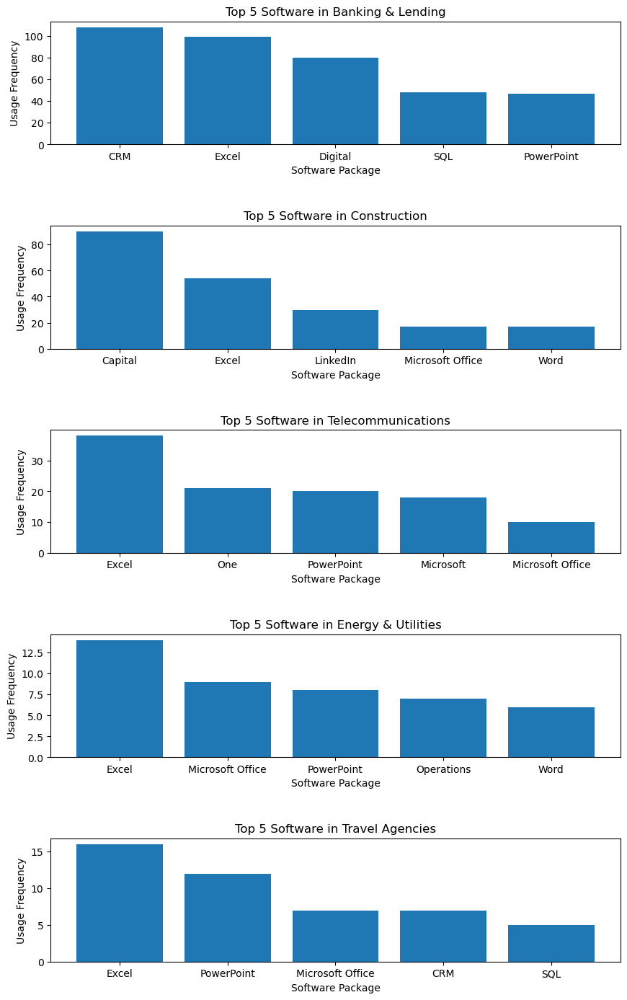

In [108]:
import pandas as pd
import matplotlib.pyplot as plt

data = Software.copy()

software_columns = data.columns[3:-1]  # Adjust this if more columns need to be excluded
industry_column = 'Industry'
industry_usage = data[industry_column].value_counts().head(5)

top_software_per_industry = {}
for industry in industry_usage.index:
    industry_data = data[data[industry_column] == industry]
    software_usage = industry_data[software_columns].sum().sort_values(ascending=False).head(5)
    top_software_per_industry[industry] = software_usage

# Visualization
fig, axes = plt.subplots(nrows=5, ncols=1, figsize=(10, 15))
fig.tight_layout(pad=6.0)

for i, (industry, software_counts) in enumerate(top_software_per_industry.items()):
    axes[i].bar(software_counts.index, software_counts.values)
    axes[i].set_title(f'Top 5 Software in {industry}')
    axes[i].set_ylabel('Usage Frequency')
    axes[i].set_xlabel('Software Package')

plt.show()

# Naive Bayes Classifier

In [23]:
soft_bayes = Software.drop(columns = ['Company','Job Description','software']).copy().dropna(subset=['Industry'])

In [24]:
from sklearn.preprocessing import LabelEncoder

X = soft_bayes.drop(columns = 'Industry')

encoder = LabelEncoder()
y = encoder.fit_transform(soft_bayes['Industry'])

In [25]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=1/3, random_state=1)

In [26]:
from sklearn.naive_bayes import BernoulliNB

naivebayes = BernoulliNB()
fit = naivebayes.fit(X_train,y_train)
preds = naivebayes.predict(X_test)
prob = naivebayes.predict_proba(X_test)

results = pd.DataFrame({'Actual':y_test,'Prediction':preds})

print('Accuracy : ',fit.score(X_test,y_test))

Accuracy :  0.5168539325842697


To evaluate the accuracy we need to understand the composition of the present classes:

In [27]:
soft_bayes['Industry'].value_counts().head(20)

Industry
Banking & Lending                              422
Construction                                   235
Telecommunications                             107
Energy & Utilities                              41
Travel Agencies                                 29
Vehicle Dealers                                 27
Construction, Repair & Maintenance Services     22
Retail & Wholesale                              19
Insurance                                       18
Information Technology                          16
Education                                       15
Grocery Stores                                  13
Energy, Mining & Utilities                      11
Management & Consulting                          9
Sports & Recreation                              9
Arts, Entertainment & Recreation                 7
Government & Public Administration               6
Rail Transportation                              6
Manufacturing                                    5
Architectural & Engine

It seems like the Naive Bayes classifier has some predictive power superior to that of random chance, but is still not doing an outstanding job.

# Clustering and dimension reduction with binary data

In [28]:
clusters = pd.DataFrame({'Industry':Software['Industry']}) #store results

In [29]:
from sklearn.cluster import DBSCAN

Software_clus = Software.drop(columns = ['Company','Job Description','Industry','software']).copy()

# We use the Jaccard distance:
dbscan1 = DBSCAN(metric='jaccard').fit(Software_clus)
labels1 = dbscan1.labels_

unique, counts = np.unique(labels1,return_counts=True)
print(dict(zip(unique,counts)))

{-1: 185, 0: 786, 1: 26, 2: 12, 3: 5, 4: 6, 5: 9, 6: 5, 7: 7, 8: 19, 9: 7}


In [30]:
clusters['cluster_jac'] = labels1.tolist()
chartclus_jac = alt.Chart(clusters).mark_point().encode(
    y = 'Industry:N',
    xOffset = 'jitter:Q',
    color = alt.Color('cluster_jac:N').scale(),
    tooltip = 'cluster_jac'
).transform_calculate(
    jitter="sqrt(-2*log(random()))*cos(2*PI*random())"
)

chartclus_jac

alt.Chart(...)

Not very satisfactory but we do seem to catch Retail jobs, Investment jobs in particular

We now do dimension reduction, since high dimensional clustering is often an issue due to the curse of dimensionality

In [31]:
#Let's try so dimension reduction algorithm before clustering
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

Software_pca = Software.drop(columns = ['Company','Job Description','Industry','software']).copy()

#pca
K = min(len(Software_pca.columns),len(Software_pca))
pca = PCA(n_components=K).fit(Software_pca)
eigen = pca.components_
Z = pca.transform(Software_pca)

column_names = []
for i in range(0,K):
    column_names.append(f'PC {i+1:d}')
    
result = pd.DataFrame(Z, columns=column_names)
result['industry'] = Software['Industry']

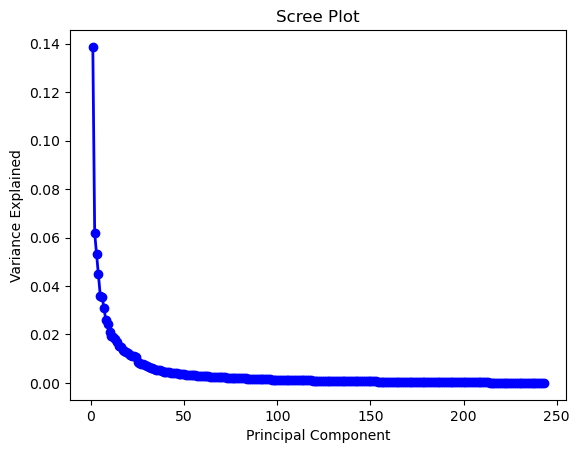

In [32]:
PC_indices = np.arange(K) + 1
plt.plot(PC_indices, pca.explained_variance_ratio_, 'o-', linewidth=2, color='blue')
plt.title('Scree Plot')
plt.xlabel('Principal Component')
plt.ylabel('Variance Explained')
plt.show()

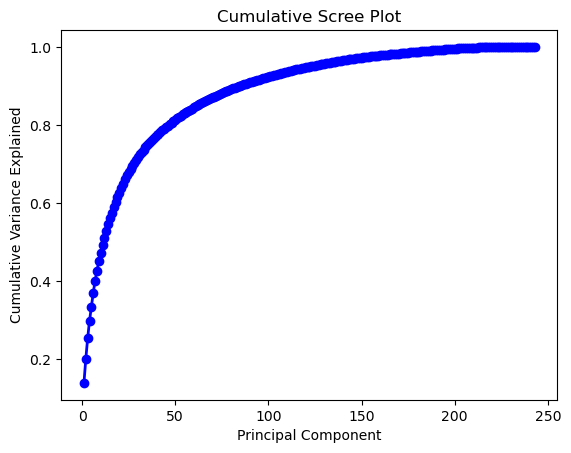

[0.8935350288283717, 0.895386859251392, 0.8972228037822388, 0.8990146965568848, 0.9007591851245236, 0.9024801023308051, 0.9041409413331193, 0.9057698724673742, 0.9073774267150969, 0.9089522570120625]


In [33]:
cumul = []
count = 0
for i in range(0,len(pca.explained_variance_ratio_)):
    count+= pca.explained_variance_ratio_[i]
    cumul.append(count)
    
PC_indices = np.arange(K) + 1
plt.plot(PC_indices, cumul, 'o-', linewidth=2, color='blue')
plt.title('Cumulative Scree Plot')
plt.xlabel('Principal Component')
plt.ylabel('Cumulative Variance Explained')
plt.show()
print(cumul[80:90])

K = 85 for variance explained above 90%

In [34]:
pc12 = alt.Chart(result).mark_point().encode(
    x = alt.X('PC 1', title = 'PC1 score'),
    y = alt.Y('PC 2', title = 'PC2 score'),
    color = 'industry:N',
    tooltip = 'industry'
).properties(title = 'PC1 vs PC2')

pc34 = alt.Chart(result).mark_point().encode(
    x = alt.X('PC 3', title = 'PC3 score'),
    y = alt.Y('PC 4', title = 'PC4 score'),
    color = 'industry:N',
    tooltip = 'industry'
).properties(title = 'PC3 vs PC4')

pc12 | pc34

alt.HConcatChart(...)

When looking at the first principal components we can visually see some clusters that seem to be mostly composed of one industry, but those are quite limited.

In [35]:
K1 = 85
pca1 = PCA(n_components=K1).fit(Software_pca)
eigen1 = pca1.components_
Z1 = pca1.transform(Software_pca)

column_names1 = []
for i in range(0,K1):
    column_names1.append(f'PC {i+1:d}')
    
Cluster_pca = pd.DataFrame(Z1, columns=column_names1)

In [36]:
dbscan2 = DBSCAN(eps=0.95, min_samples = 15).fit(Cluster_pca)
labels2 = dbscan2.labels_

unique, counts = np.unique(labels2,return_counts=True)
print(dict(zip(unique,counts)))

{-1: 573, 0: 34, 1: 130, 2: 93, 3: 15, 4: 54, 5: 33, 6: 20, 7: 16, 8: 15, 9: 19, 10: 65}


In [37]:
clusters['cluster_pca1'] = labels2.tolist()
chartclus_pca1 = alt.Chart(clusters).mark_point().encode(
    y = 'Industry:N',
    xOffset = 'jitter:Q',
    color = alt.Color('cluster_pca1:N')
).transform_calculate(
    jitter="sqrt(-2*log(random()))*cos(2*PI*random())"
)

Cluster_pca['Cluster'] = labels2.tolist()

chartpca_clus1 = alt.Chart(Cluster_pca).mark_point().encode(
    x = alt.X('PC 1', title = 'PC1 score'),
    y = alt.Y('PC 2', title = 'PC2 score'),
    color = 'Cluster:N'
).properties(title = 'PC1 vs PC2')

chartclus_pca1 | chartpca_clus1

alt.HConcatChart(...)

That is a lot of clusters, and it visually doesn't line up with what we would hope... PCA leaves us with too many features, so we are still stuck with the CoD

In [38]:
#Let's try different parameters for DBSCAN

#Cluster_pca = Cluster_pca.drop(columns = ['Cluster']) #we drop the cluster column we added for the above graphs

dbscan3 = DBSCAN(eps=0.5,min_samples = 10).fit(Cluster_pca)
labels3 = dbscan3.labels_

unique, counts = np.unique(labels3,return_counts=True)
print(dict(zip(unique,counts)))

{-1: 586, 0: 30, 1: 26, 2: 93, 3: 12, 4: 55, 5: 15, 6: 11, 7: 50, 8: 27, 9: 17, 10: 14, 11: 16, 12: 10, 13: 14, 14: 19, 15: 62, 16: 10}


In [39]:
clusters['cluster_pca2'] = labels3.tolist()
chartclus_pca2 = alt.Chart(clusters).mark_point().encode(
    y = 'Industry:N',
    xOffset = 'jitter:Q',
    color = alt.Color('cluster_pca2:N')
).transform_calculate(
    jitter="sqrt(-2*log(random()))*cos(2*PI*random())"
)

Cluster_pca['Cluster2'] = labels3.tolist()

chartpca_clus2 = alt.Chart(Cluster_pca).mark_point().encode(
    x = alt.X('PC 1', title = 'PC1 score'),
    y = alt.Y('PC 2', title = 'PC2 score'),
    color = 'Cluster2:N'
).properties(title = 'PC1 vs PC2')

chartpca_clus2_ = alt.Chart(Cluster_pca).mark_point().encode(
    x = alt.X('PC 3', title = 'PC3 score'),
    y = alt.Y('PC 4', title = 'PC4 score'),
    color = 'Cluster2:N'
).properties(title = 'PC3 vs PC4')

chartclus_pca2 | chartpca_clus2 | chartpca_clus2_ 

alt.HConcatChart(...)

Try more clustering techniques:

In [40]:
from sklearn.cluster import SpectralClustering

Software_clus = Software.drop(columns=['Company', 'Job Description', 'Industry', 'software']).copy()

# Perform spectral clustering
n_clusters = 10
spectral_model = SpectralClustering(n_clusters=n_clusters, affinity='nearest_neighbors', n_neighbors=10, random_state=1)
labels_spectral = spectral_model.fit_predict(Software_clus)

clusters = pd.DataFrame({'Industry': Software['Industry'], 'cluster_spectral': labels_spectral})
clusters_melted = pd.melt(clusters, id_vars=['Industry'], var_name='cluster_type', value_name='cluster')

# Visualize the clusters
chart_spectral = alt.Chart(clusters_melted).mark_point().encode(
    xOffset = 'jitter:Q',
    y='Industry:N',
    color=alt.Color('cluster:N', title='Spectral Clustering'),
    tooltip=['Industry:N', 'cluster_spectral:N']
).transform_calculate(
    jitter="sqrt(-2*log(random()))*cos(2*PI*random())"
).properties(
    height=600
)

chart_spectral

alt.Chart(...)

In [41]:
clusters_melted.head(20)

,Industry,cluster_type,cluster
0,Rail Transportation,cluster_spectral,0
1,Rail Transportation,cluster_spectral,7
2,Rail Transportation,cluster_spectral,7
3,Rail Transportation,cluster_spectral,7
4,Telecommunications,cluster_spectral,0
5,Telecommunications,cluster_spectral,0
6,Telecommunications,cluster_spectral,8
7,Telecommunications,cluster_spectral,0
8,Telecommunications,cluster_spectral,0
9,Education,cluster_spectral,0


We can switch to another dimension reduction method. Let's try tSNE:

In [42]:
#tsne
from sklearn.manifold import TSNE
Software_tsne = Software.drop(columns = ['Company','Job Description','Industry','software']).copy()

tsne1 = TSNE(n_components=2)
X_tsne1 = tsne1.fit_transform(Software_tsne)

tsne_df = pd.DataFrame(X_tsne1, columns=['z1', 'z2'])

tsne_df['label'] = Software['Industry']

alt.Chart(tsne_df).mark_point().encode(
    x = 'z1',
    y = 'z2',
    color = 'label:N',
    tooltip = 'label'
).properties(title = 'TSNE Representation')

alt.Chart(...)

We can see some interesting cluster form, in particular construction seem to have been isolated, a cluster at the bottom is mostly banking jobs....

In [43]:
# We can cluster the tsne graph...

X_tsne = tsne_df[['z1', 'z2']]

# Perform DBSCAN clustering
dbscan_model = DBSCAN(eps=7.37, min_samples=5)  # You can adjust eps and min_samples
labels_dbscan = dbscan_model.fit_predict(X_tsne)

tsne_df['cluster_dbscan'] = labels_dbscan.astype(str)

alt.Chart(tsne_df).mark_point().encode(
    x='z1',
    y='z2',
    color='cluster_dbscan:N',
    tooltip=['label', 'cluster_dbscan']
).properties(title='Clustered t-SNE Representation with DBSCAN')

alt.Chart(...)

# Clustering with list of software

In [44]:
list_cluster = pd.DataFrame({'Industry':Software['Industry']}) #store results

In [45]:
#first use .vector from nlp_md model to extract 300 features space from the text
software_vec = []
software_list = Software[['software']]
for i in range(0,len(software_list)):
    doc = nlp_md(software_list.iloc[i,0])
    features = doc.vector.tolist()
    software_vec.append(features)
    
software_vector = pd.DataFrame(software_vec)

In [46]:
#We try many DBSCAN algorithms
db_list1 = DBSCAN(eps=0.05,min_samples=10,metric='cosine').fit(software_vector)
labels_list1 = db_list1.labels_

unique, counts = np.unique(labels_list1,return_counts=True)
print(dict(zip(unique,counts)))

{-1: 145, 0: 881, 1: 22, 2: 19}


In [47]:
list_cluster['cluster1'] = labels_list1.tolist()
chartclus1 = alt.Chart(list_cluster).mark_point().encode(
    y = 'Industry:N',
    xOffset = 'jitter:Q',
    color = alt.Color('cluster1:N').scale()
).transform_calculate(
    jitter="sqrt(-2*log(random()))*cos(2*PI*random())"
)

chartclus1

alt.Chart(...)

The results are not very satisfary but do provide some interesting insight. Retail & Wholesale in particular seem to have been captured by the clustering algorithm.

Remember that clustering in such a high-dimensional space is not ideal due to the curse of dimensionality.

Let's try dimension reduction, so can pick a more suitable min_samples in DBSCAN (commonly twice the number of features):

In [48]:
#We try PCA:
K_list = min(len(software_vector.columns),len(software_vector))
pca_list = PCA(n_components=K_list).fit(software_vector)
eigen_list = pca_list.components_
Z_list = pca_list.transform(software_vector)

column_names_list = []
for i in range(0,K_list):
    column_names_list.append(f'PC {i+1:d}')
    
res_list = pd.DataFrame(Z_list, columns=column_names_list)
res_list['industry'] = Software['Industry']

In [49]:
alt.Chart(res_list).mark_point().encode(
    x = alt.X('PC 1', title = 'PC1 score'),
    y = alt.Y('PC 2', title = 'PC2 score'),
    color = 'industry:N'
).properties(title = 'PC1 vs PC2')

alt.Chart(...)

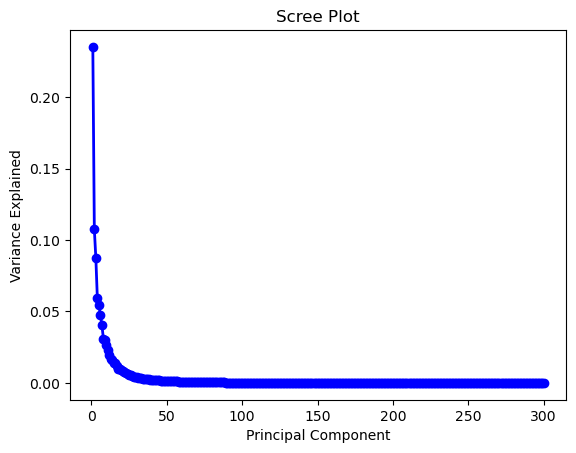

In [50]:
PC_indices_list = np.arange(K_list) + 1
plt.plot(PC_indices_list, pca_list.explained_variance_ratio_, 'o-', linewidth=2, color='blue')
plt.title('Scree Plot')
plt.xlabel('Principal Component')
plt.ylabel('Variance Explained')
plt.show()

In [51]:
cumul_list = []
count_list = 0
for i in range(0,len(pca_list.explained_variance_ratio_)):
    count_list+= pca_list.explained_variance_ratio_[i]
    cumul_list.append(count_list)
    
cumul_list[15:26]

[0.8242554772435399,
 0.835929730010905,
 0.8459644726467177,
 0.855379109525732,
 0.8641708410484872,
 0.8723752829951581,
 0.8800250582369206,
 0.8868185653906857,
 0.893230910533519,
 0.8990450077275062,
 0.9042460077217291]

Let's pick K=25 (it is very close to 90% and is a round number)

In [52]:
K7 = 25
pca7 = PCA(n_components=K7).fit(software_vector)
eigen7 = pca7.components_
Z7 = pca7.transform(software_vector)

column_names7 = []
for i in range(0,K7):
    column_names7.append(f'PC {i+1:d}')
    
Cluster7pca = pd.DataFrame(Z7, columns=column_names7)

In [53]:
#pick min_samples = 2*25
dbscan7 = DBSCAN(eps=0.31,min_samples=50,metric='cosine').fit(Cluster7pca)
labels7 = dbscan7.labels_

unique7, counts7 = np.unique(labels7,return_counts=True)
print(dict(zip(unique7,counts7)))

{-1: 363, 0: 440, 1: 151, 2: 113}


In [54]:
list_cluster['cluster2'] = labels7.tolist()
chartclus2 = alt.Chart(list_cluster).mark_point().encode(
    y = 'Industry:N',
    xOffset = 'jitter:Q',
    color = alt.Color('cluster2:N').scale()
).transform_calculate(
    jitter="sqrt(-2*log(random()))*cos(2*PI*random())"
)

chartclus2

alt.Chart(...)

Again not the most satisfactory but the clustering algorithm does seem to recognize some industries

In [55]:
#Try different clustering srategy on the 25 PC data


Let's do wordclouds of the clusters we found. We hope to find software that appear at different rate between clusters


In [56]:
list_cluster

,Industry,cluster1,cluster2
0,Rail Transportation,0,0
1,Rail Transportation,0,0
2,Rail Transportation,0,0
3,Rail Transportation,0,-1
4,Telecommunications,-1,-1
...,...,...,...
1062,Grocery Stores,0,0
1063,Vehicle Dealers,0,-1
1064,Vehicle Dealers,0,-1
1065,Banking & Lending,0,0


The problem encountered with PCA is we are stuck with a high number of PCs to explain a reasonable amount of the variance. This is problematic when clustering, the curse of dimensionality really kicks in

In [57]:
#Let's try tSNE

tsne1 = TSNE(n_components=2)
X_tsne1 = tsne1.fit_transform(software_vector)

tsne_df1 = pd.DataFrame(X_tsne1, columns=['z1', 'z2'])

tsne_df1['label'] = Software['Industry']

alt.Chart(tsne_df1).mark_point().encode(
    x = 'z1',
    y = 'z2',
    color = 'label:N',
    tooltip = 'label'
).properties(title = 'TSNE Representation')

alt.Chart(...)

tSNE seems to pick up few industries in this case, less than when we used binary data. It again isolated Retail & Wholesale

In [58]:
#In order to analyse the tSNE cluster, we can perform DBSCAN of this graph

In [76]:
#Let's try UMAP:
import umap

X_tsne = tsne_df[['z1', 'z2']]

umap_model = umap.UMAP(random_state=1)
umap_result = umap_model.fit_transform(X_tsne)
umap_df = pd.DataFrame({'umap_1': umap_result[:, 0], 'umap_2': umap_result[:, 1], 'label': tsne_df['label'], 'cluster_dbscan': tsne_df['cluster_dbscan']})

chart_umap = alt.Chart(umap_df).mark_point().encode(
    x='umap_1:Q',
    y='umap_2:Q',
    color='label:N',
    tooltip=['label:N', 'cluster_dbscan:N']
).properties(title='UMAP Representation', width=500, height=500)

chart_umap

alt.Chart(...)

Construction and Banking & Lending seem to always show up in small, dense balls which preserve their local structure at every run.

We perform DBScan on our UMAP representation:

In [89]:
umap_coordinates = umap_df[['umap_1', 'umap_2']].values

dbscan = DBSCAN(eps=3, min_samples=5)
umap_df['cluster_dbscan'] = dbscan.fit_predict(umap_coordinates)

chart_umap = alt.Chart(umap_df).mark_point().encode(
    x='umap_1:Q',
    y='umap_2:Q',
    color='cluster_dbscan:N',
    tooltip=['label:N', 'cluster_dbscan:N']
).properties(title='UMAP Representation with DBSCAN Clustering', width=500, height=500)

chart_umap

alt.Chart(...)

We represent the leading industries in each cluster:

In [90]:
cluster_industry_info = umap_df.copy().groupby('cluster_dbscan')['label'].apply(lambda x: x.mode().iloc[0]).reset_index()
cluster_industry_info

,cluster_dbscan,label
0,0,Banking & Lending
1,1,Banking & Lending
2,2,Telecommunications
3,3,Banking & Lending
4,4,Banking & Lending
5,5,Investment & Asset Management
6,6,Banking & Lending
7,7,Banking & Lending
8,8,Banking & Lending
9,9,Banking & Lending


# Hypothesis Testing

**Individual Software Usage Across Industries:**

H0: There is no significant difference in software usage across different industries. 

H1: Software usage varies significantly across industries.

In [91]:
from scipy.stats import f_oneway

industry_groups = [Software['Photoshop'][Software['Industry'] == industry] for industry in Software['Industry'].unique()]
f_statistic, p_value = f_oneway(*industry_groups)

print(f'ANOVA F-statistic: {f_statistic}')
print(f'P-value: {p_value}')

ANOVA F-statistic: 1.8158112061243117
P-value: 0.0020112753560428426


In [93]:
Software

,Company,Industry,Job Description,Microsoft Office,Microsoft,Excel,Short,Solution,PowerPoint,SAP BPC,...,Distribution,Safety,UML,QGIS,Family,Common,matplotlib,Illustrator,Dashboard,software
0,Canadian Pacific,Rail Transportation,\nCanadian Pacific (CP) and Kansas City Southe...,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,"Microsoft Office,"
1,Canadian Pacific,Rail Transportation,\nCanadian Pacific (CP) and Kansas City Southe...,0,1,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,"Microsoft, Excel,"
2,Canadian Pacific,Rail Transportation,\nCanadian Pacific (CP) and Kansas City Southe...,0,1,1,1,1,1,0,...,0,0,0,0,0,0,0,0,0,"Microsoft, Excel, Short, Solution, PowerPoint,"
3,Canadian Pacific,Rail Transportation,\nCanadian Pacific (CP) and Kansas City Southe...,0,0,1,0,0,0,1,...,0,0,0,0,0,0,0,0,0,"Excel, SAP BPC, Finance, Information Services,..."
4,NOKIA,Telecommunications,\n\n\n Join us in creating the technology th...,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,"Engineering, One, Identity Management,"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1062,Maxi Chambly,Grocery Stores,Nous recherchons des responsables talentueux e...,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,"Microsoft Office,"
1063,Loblaw Companies Limited,Vehicle Dealers,\nReferred applicants must not apply directly ...,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,"Windows,"
1064,Loblaw Companies Limited,Vehicle Dealers,\nReferred applicants should not apply directl...,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,"Windows,"
1065,PC Financial,Banking & Lending,\nReferred applicants should not apply directl...,1,0,1,0,0,1,0,...,0,0,0,0,0,0,0,0,0,"Microsoft Office, Excel, PowerPoint, Access, F..."


**Correlation Between Appearance of Industries:**

H0: There is no significant correlation between two specific software. 

H1: There is significant correlation between two specific software.

In [63]:
from scipy.stats import pearsonr

correlation, p_value = pearsonr(Software['matplotlib'], Software['Python'])
print("Correlation coefficient:", correlation)
print("P-value:", p_value)

Correlation coefficient: 0.3320801960652279
P-value: 6.947360561671704e-29


# Visualization

First, we will find the counts for most used software in our data.

In [109]:
tsne_df

,z1,z2,label,cluster_dbscan
0,3.464100,55.441021,Rail Transportation,0
1,-48.960300,-2.823981,Rail Transportation,1
2,-60.156311,-9.627668,Rail Transportation,1
3,-7.590451,-13.677516,Rail Transportation,1
4,29.597485,66.304871,Telecommunications,2
...,...,...,...,...
1062,-0.024529,56.061535,Grocery Stores,0
1063,55.914387,7.742824,Vehicle Dealers,4
1064,55.914387,7.742824,Vehicle Dealers,4
1065,-31.752087,-26.296028,Banking & Lending,1


In [110]:
list_cluster[list_cluster['cluster1'] != list_cluster['cluster2']]

,Industry,cluster1,cluster2
3,Rail Transportation,0,-1
5,Telecommunications,1,-1
9,Education,0,-1
11,Management & Consulting,0,1
13,Financial Services,0,1
...,...,...,...
1054,Retail & Wholesale,2,-1
1060,Vehicle Dealers,0,-1
1063,Vehicle Dealers,0,-1
1064,Vehicle Dealers,0,-1


In [111]:
industry_counts = tsne_df['cluster_dbscan'].value_counts()

print(industry_counts)

cluster_dbscan
1     441
3      96
4      73
19     66
7      60
0      59
-1     57
5      31
2      28
6      28
17     19
8      18
11     17
20     12
15     10
21      9
10      8
18      7
9       7
14      6
16      5
13      5
12      5
Name: count, dtype: int64


Let's produce some visualizations from this.

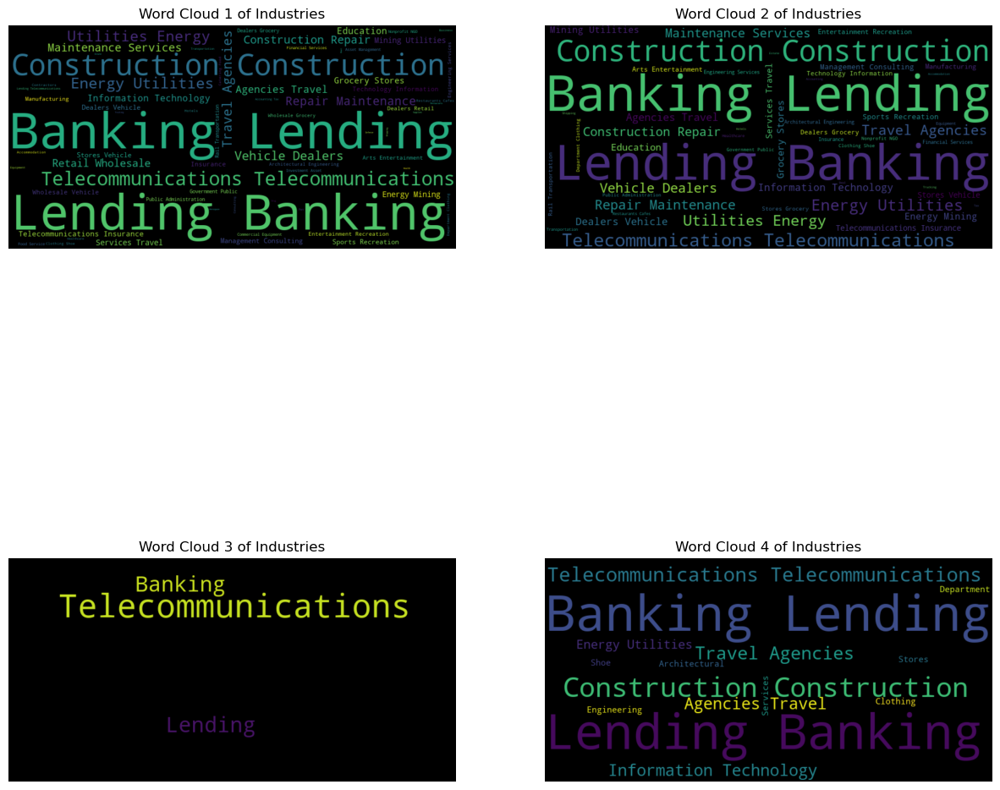

In [114]:
from wordcloud import WordCloud, STOPWORDS

industry_cluster1 = tsne_df['label'].tolist()
industry_cluster2 = list_cluster[list_cluster['cluster1'] == 0]['Industry'].tolist()
industry_cluster3 = list_cluster[list_cluster['cluster1'] == 1]['Industry'].tolist()
industry_cluster4 = list_cluster[list_cluster['cluster2'] == 2]['Industry'].tolist()

# Prepare the text for word clouds
text_cluster1 = ' '.join(industry_cluster1)
text_cluster2 = ' '.join(industry_cluster2)
text_cluster3 = ' '.join(industry_cluster3)
text_cluster4 = ' '.join(industry_cluster4)

# Generate word clouds with stopwords
wordcloud1 = WordCloud(width=800, height=400).generate(text_cluster1)
wordcloud2 = WordCloud(width=800, height=400).generate(text_cluster2)
wordcloud3 = WordCloud(width=800, height=400).generate(text_cluster3)
wordcloud4 = WordCloud(width=800, height=400).generate(text_cluster4)

# Display the word clouds
plt.figure(figsize=(15, 15))

# Word Cloud 1
plt.subplot(2, 2, 1)  # 2 rows, 2 columns, plot number 1
plt.imshow(wordcloud1, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud 1 of Industries')

# Word Cloud 2
plt.subplot(2, 2, 2)  # 2 rows, 2 columns, plot number 2
plt.imshow(wordcloud2, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud 2 of Industries')

# Word Cloud 3
plt.subplot(2, 2, 3)  # 2 rows, 2 columns, plot number 3
plt.imshow(wordcloud3, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud 3 of Industries')

# Word Cloud 4
plt.subplot(2, 2, 4)  # 2 rows, 2 columns, plot number 4
plt.imshow(wordcloud4, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud 4 of Industries')

plt.show()

In [115]:
c1_1 = list_cluster[list_cluster['cluster1'] == -1]
c1_2 = list_cluster[list_cluster['cluster1'] == 0]
c1_3 = list_cluster[list_cluster['cluster1'] == 1]
c1_4 = list_cluster[list_cluster['cluster1'] == 2]

# Create a histogram for each filtered DataFrame
hist_1 = alt.Chart(tsne_df).mark_bar().encode(
    x="label",
    y='count()',
)

hist_2 = alt.Chart(c1_2).mark_bar().encode(
    x="Industry",
    y='count()',
)

hist_3 = alt.Chart(c1_3).mark_bar().encode(
    x="Industry",
    y='count()',
)

hist_4 = alt.Chart(c1_4).mark_bar().encode(
    x="Industry",
    y='count()',
)

# Combine the histograms into a 2x2 grid
alt.vconcat(
    alt.hconcat(hist_1, hist_2),
    alt.hconcat(hist_3, hist_4)
)

alt.VConcatChart(...)

We see that a vast majority of our data comes from the Banking & Lending and Construction industries. Next, let's see what software are mostly used.

In [116]:
software_counts = Software['software'].value_counts()

print(software_counts)

software
CRM,                                                                 93
Capital,                                                             59
Excel,                                                               42
Microsoft Office,                                                    28
Digital,                                                             25
                                                                     ..
SQL, Knowledge, API, IBM,                                             1
Java, DevOps, Digital, SQL,                                           1
Power BI, Tableau, Spark, Big Data, Cloud Platform,                   1
Linux, Shell, Python,                                                 1
Microsoft Office, Excel, PowerPoint, Access, Financial Services,      1
Name: count, Length: 415, dtype: int64


In [117]:
tsne_df

,z1,z2,label,cluster_dbscan
0,3.464100,55.441021,Rail Transportation,0
1,-48.960300,-2.823981,Rail Transportation,1
2,-60.156311,-9.627668,Rail Transportation,1
3,-7.590451,-13.677516,Rail Transportation,1
4,29.597485,66.304871,Telecommunications,2
...,...,...,...,...
1062,-0.024529,56.061535,Grocery Stores,0
1063,55.914387,7.742824,Vehicle Dealers,4
1064,55.914387,7.742824,Vehicle Dealers,4
1065,-31.752087,-26.296028,Banking & Lending,1


In [125]:
tsne_df['software'] = Software['software']
tsne_dft = tsne_df[tsne_df['cluster_dbscan'] == '20']
tsne_df22 = tsne_df[tsne_df['cluster_dbscan'] == '22']
tsne_df3 = tsne_df[tsne_df['cluster_dbscan'] == '3']
tsne_df0 = tsne_df[tsne_df['cluster_dbscan'] == '0']
tsne_df20 = tsne_df[tsne_df['cluster_dbscan'] == '20']
tsne_df10 = tsne_df[tsne_df['cluster_dbscan'] == '10']
tsne_df15 = tsne_df[tsne_df['cluster_dbscan'] == '15']
tsne_df5 = tsne_df[tsne_df['cluster_dbscan'] == '5']
tsne_df8 = tsne_df[tsne_df['cluster_dbscan'] == '8']
tsne_df1 = tsne_df[tsne_df['cluster_dbscan'] == '1']
tsne_df4 = tsne_df[tsne_df['cluster_dbscan'] == '4']
tsne_df7 = tsne_df[tsne_df['cluster_dbscan'] == '7']
tsne_df24 = tsne_df[tsne_df['cluster_dbscan'] == '24']

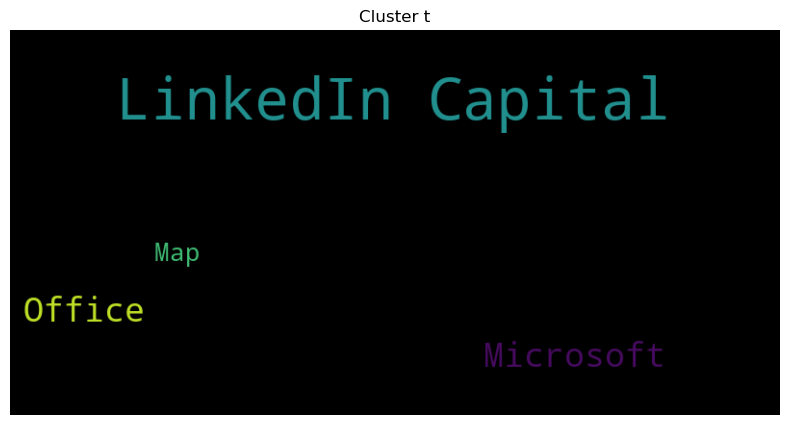

In [131]:
# Define a function to generate a word cloud
def generate_wordcloud(df, title):
    # Flatten the list
    software_list = [software for sublist in df['software'].str.split(',').tolist() for software in sublist]
    
    # Join the list into a single string
    software_text = ' '.join(software_list)
    
    # Generate the word cloud
    wordcloud = WordCloud(width=800, height=400).generate(software_text)
    
    # Display the word cloud
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(title)
    plt.show()

generate_wordcloud(tsne_dft, 'Cluster t')

In [127]:
def histogram_maker_10000(dataframe):
    software_list = [software for sublist in dataframe['software'].str.split(',').tolist() for software in sublist]

    # Create a DataFrame from the list
    software_df = pd.DataFrame(software_list, columns=['software'])

    # Count the frequency of each software
    software_counts = software_df['software'].value_counts().reset_index()
    software_counts.columns = ['software', 'count']

    # Select the top 15 software
    top_15_software = software_counts.iloc[1:16]

    # Bar chart of word frequencies
    chart = alt.Chart(top_15_software).mark_bar().encode(
        x='count', 
        y=alt.Y('software', sort='-x')
    )
    
    return chart

histogram_maker_10000(tsne_df22)

alt.Chart(...)

We keep exploring clusters:

In [128]:

histogram_maker_10000(tsne_df3)

alt.Chart(...)

In [133]:

histogram_maker_10000(tsne_df0)

alt.Chart(...)

In [134]:

histogram_maker_10000(tsne_df20)

alt.Chart(...)

In [135]:

histogram_maker_10000(tsne_df20)

alt.Chart(...)

In [136]:
histogram_maker_10000(tsne_df15)

alt.Chart(...)

In [137]:
histogram_maker_10000(tsne_df15)

alt.Chart(...)

In [138]:
histogram_maker_10000(tsne_df8)

alt.Chart(...)

In [139]:
histogram_maker_10000(tsne_df1)

alt.Chart(...)

In [140]:
histogram_maker_10000(tsne_df4)

alt.Chart(...)

In [141]:
histogram_maker_10000(tsne_df7)

alt.Chart(...)

In [142]:
histogram_maker_10000(tsne_df24)

alt.Chart(...)

In [143]:
list_cluster['software'] = Software['software']

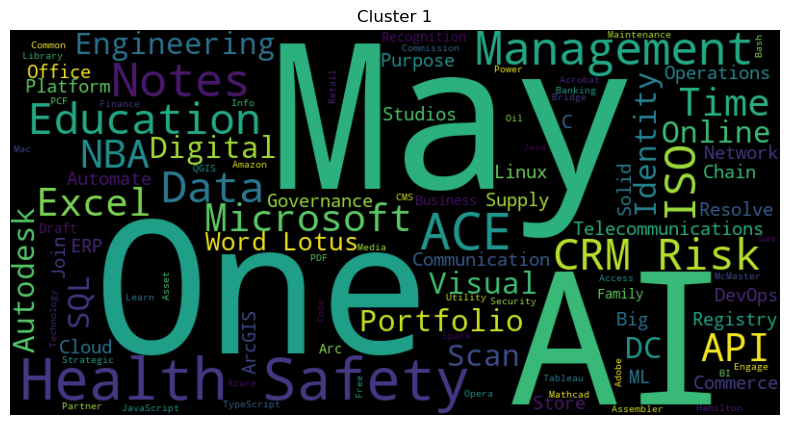

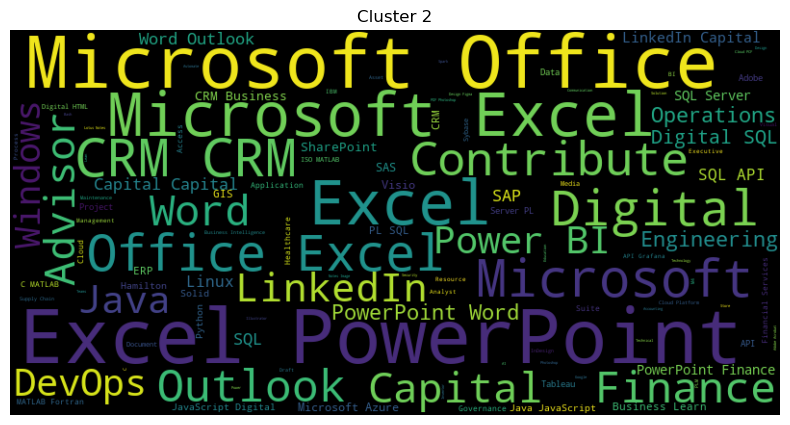

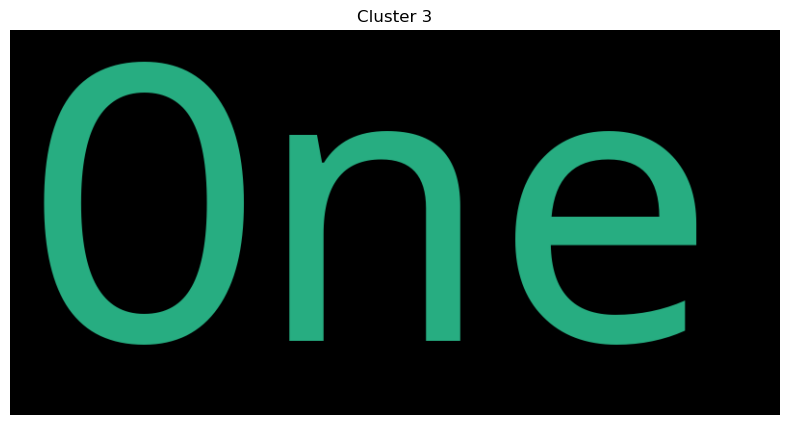

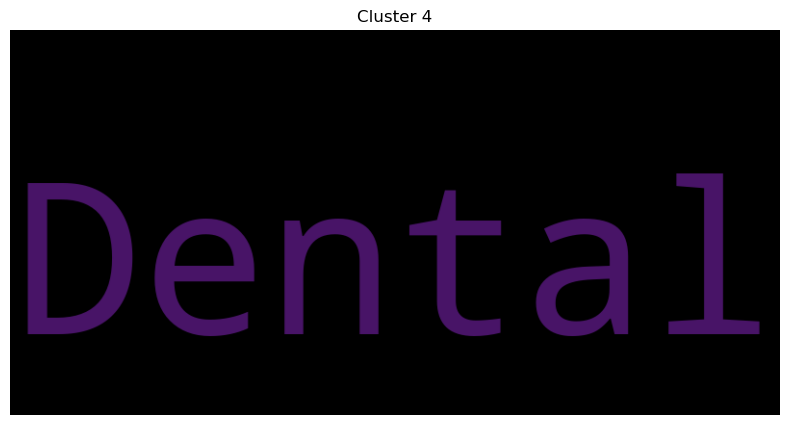

In [144]:
c1_wc1 = list_cluster[list_cluster['cluster1'] == -1]
c1_wc2 = list_cluster[list_cluster['cluster1'] == 0]
c1_wc3 = list_cluster[list_cluster['cluster1'] == 1]
c1_wc4 = list_cluster[list_cluster['cluster1'] == 2]

generate_wordcloud(c1_wc1, 'Cluster 1')
generate_wordcloud(c1_wc2, 'Cluster 2')
generate_wordcloud(c1_wc3, 'Cluster 3')
generate_wordcloud(c1_wc4, 'Cluster 4')

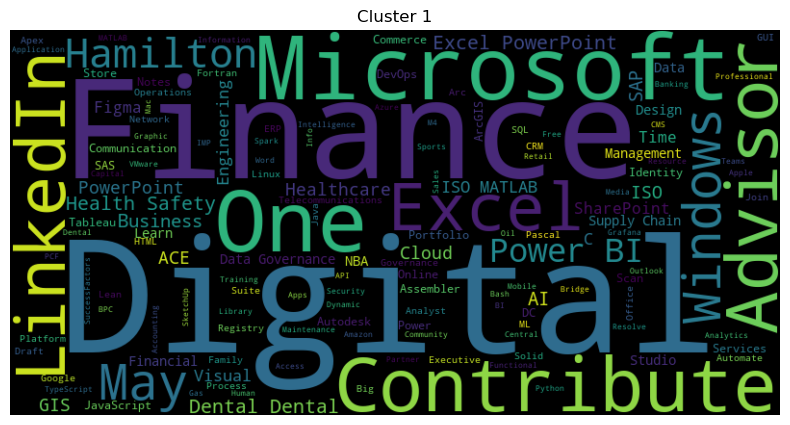

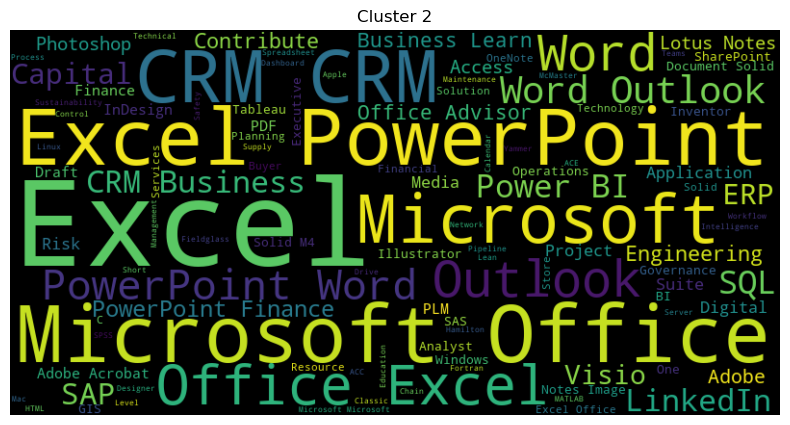

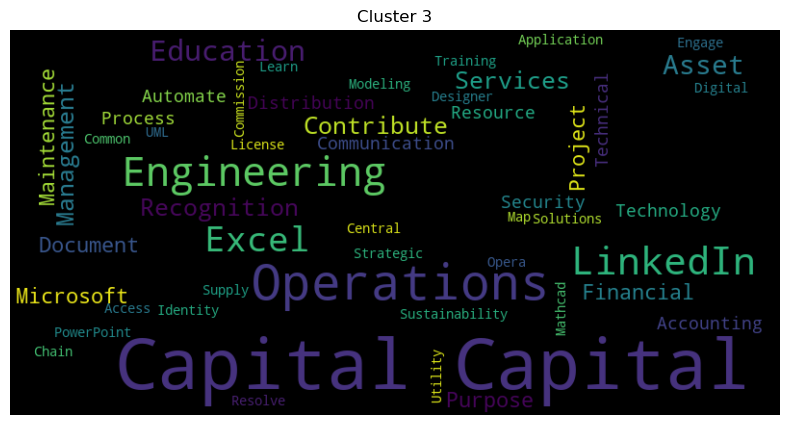

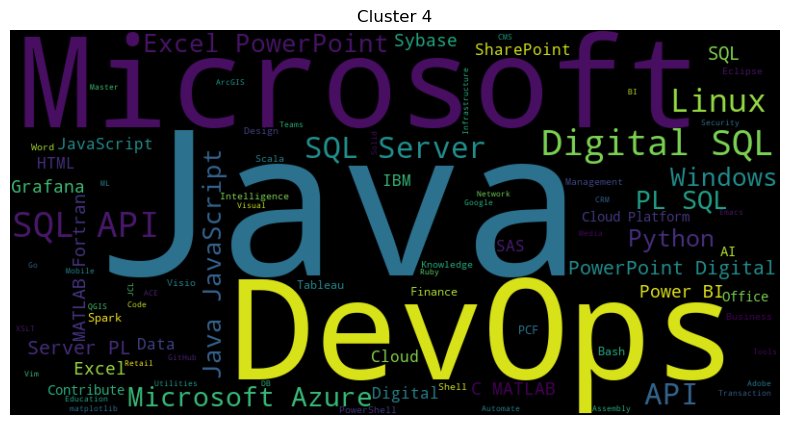

In [145]:
c2_wc1 = list_cluster[list_cluster['cluster2'] == -1]
c2_wc2 = list_cluster[list_cluster['cluster2'] == 0]
c2_wc3 = list_cluster[list_cluster['cluster2'] == 1]
c2_wc4 = list_cluster[list_cluster['cluster2'] == 2]

generate_wordcloud(c2_wc1, 'Cluster 1')
generate_wordcloud(c2_wc2, 'Cluster 2')
generate_wordcloud(c2_wc3, 'Cluster 3')
generate_wordcloud(c2_wc4, 'Cluster 4')